In [1]:
import os, sys

In [2]:
sys.path.append('../')

In [3]:
from core.utils.data import define_dataset, select_dist

In [4]:
from core.utils.inference import inference_phase_rUNet, inference_phase_rUNet_plot_notebook

In [5]:
from core.models import rUNet

In [6]:
from tqdm.notebook import tqdm

In [7]:
import torch

In [8]:
import matplotlib.pyplot as plt

In [9]:
root_folder_pos2 = '/storage/yw18581/data/Pos2_time1934_8bit_cropped/top_right_1/'

In [10]:
root_folder_pos2_2 = '/storage/yw18581/data/Pos2_time1934_8bit_cropped/top_right_2/'

In [11]:
root_folder_pos2_3 = '/storage/yw18581/data/Pos2_time1934_8bit_cropped/top_right_3/'

In [12]:
root_folder_pos2_4 = '/storage/yw18581/data/Pos2_time1934_8bit_cropped/top_right_4/'

In [13]:
root_folder_pos2_5 = '/storage/yw18581/data/Pos2_time1934_8bit_cropped/top_right_5/'

In [14]:
root_folder_pos2_6 = '/storage/yw18581/data/Pos2_time1934_8bit_cropped/top_right_6/'

In [15]:
from torchvision import transforms

In [16]:
sys.path.append('../')

In [17]:
from torch.utils.data import DataLoader

In [18]:
from core.utils.data.transformers import ChannelsFirst, ToTensor

In [19]:
from core.utils.data.dataset import UNetDatasetImagesOnly

In [20]:
model = rUNet(out_size=1)

In [21]:
torch.cuda.empty_cache()

In [22]:
checkpoint=torch.load('/storage/yw18581/src/leaf_reco/saved_models/trained_6positions_multi_loss/Trained_rUNet_pytorch_6positions_dataset_100epochs_0.4coeff_mask.pkl')['model_state_dict']

In [23]:
model.load_state_dict(checkpoint)

<All keys matched successfully>

In [24]:
device = torch.device("cuda:{}".format(0) if torch.cuda.is_available() else "cpu")
model.eval()
model.to(device);

In [25]:
import numpy as np

In [34]:
def define_dataset(root_folder, fname_key='File', file_extension='.tiff', batch_size=1, validation_split=0.2, test_split=0.2,
                   excluded_list=None, include_list=None, load_mask = True,  scale=0.25, multi_processing=0, alldata=False):
    excluded = excluded_list
    include = include_list
    composed = transforms.Compose([ChannelsFirst(), ToTensor()])
    if load_mask:
        dataset = UNetDatasetFromFolders(root_folder, fname_key=fname_key, file_extension=file_extension, excluded=excluded, included=include, transform=composed)
    else:
        dataset = UNetDatasetImagesOnly(root_folder, fname_key=fname_key, file_extension=file_extension,
                                         excluded=excluded, included=include, transform=composed)
    if alldata:
        data_loaders = DataLoader(dataset, batch_size=batch_size, num_workers=multi_processing)
        data_lengths = len(dataset)
    else:
        data_loaders, data_lengths = splitter_train_val_test(dataset,
                                                             validation_split,
                                                             test_split,
                                                             batch=batch_size,
                                                             workers=multi_processing)
    return data_loaders, data_lengths

In [35]:
data_loaders, data_lengths = define_dataset(root_folder=root_folder_pos2_3, fname_key='File',alldata=True, load_mask=False)

In [36]:
data_lengths

201

In [48]:
for batch in data_loaders:
    tr = batch['image'].float()/255
    print(tr[0,0,...])
    break

tensor([[0.8471, 0.5961, 0.6941,  ..., 0.5176, 0.4902, 0.3176],
        [0.6941, 0.8157, 0.6784,  ..., 0.6745, 0.8510, 0.3137],
        [0.7451, 0.7843, 0.6588,  ..., 0.4392, 0.8667, 0.3176],
        ...,
        [0.5686, 0.5059, 0.6627,  ..., 0.4431, 0.4471, 0.3098],
        [0.6314, 0.6980, 0.7922,  ..., 0.7529, 0.5765, 0.3137],
        [0.7725, 0.5098, 0.5412,  ..., 0.8353, 0.4706, 0.3098]])


batch 1, corr -1.0
1: pred_dist: [2.3870804]


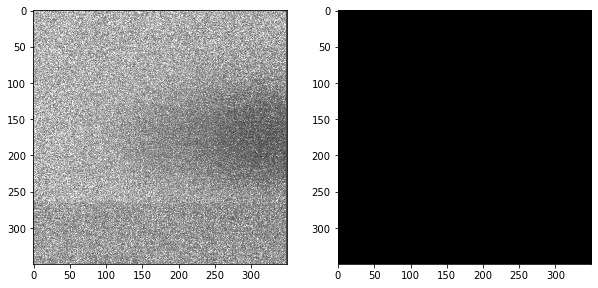

batch 2, corr -1.0
1: pred_dist: [2.4499557]


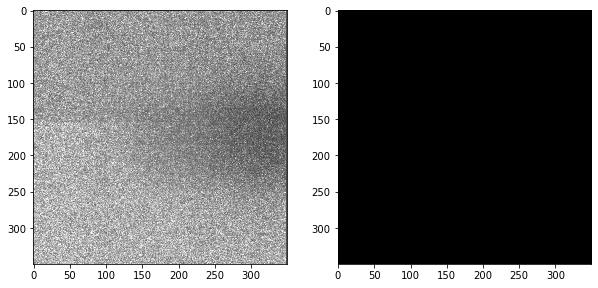

batch 1, corr -0.8
1: pred_dist: [2.256294]


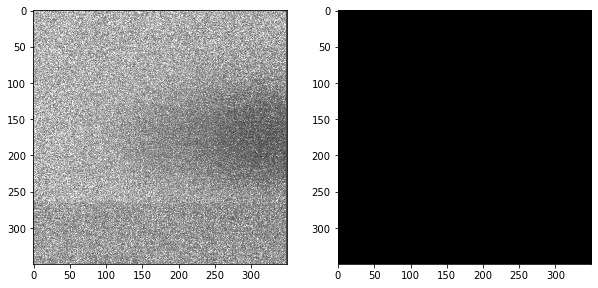

batch 2, corr -0.8
1: pred_dist: [2.3327646]


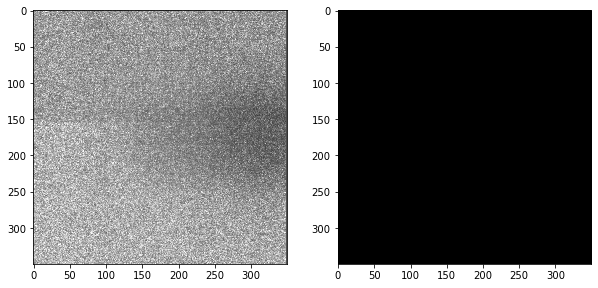

batch 1, corr -0.6000000000000001
1: pred_dist: [2.1307967]


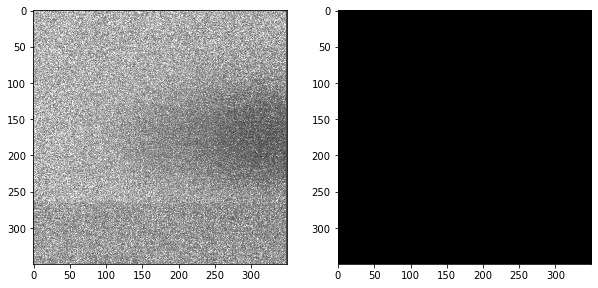

batch 2, corr -0.6000000000000001
1: pred_dist: [2.2226784]


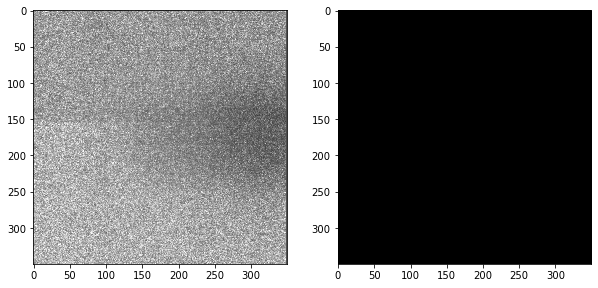

batch 1, corr -0.40000000000000013
1: pred_dist: [1.9219006]


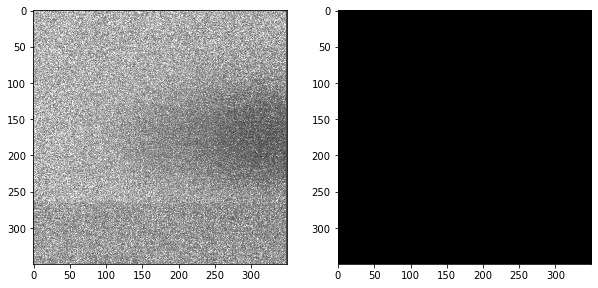

batch 2, corr -0.40000000000000013
1: pred_dist: [2.086043]


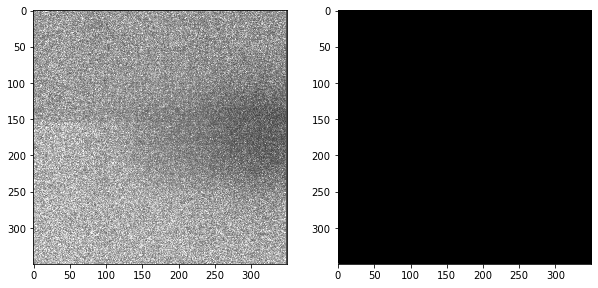

batch 1, corr -0.20000000000000018
1: pred_dist: [47.209404]


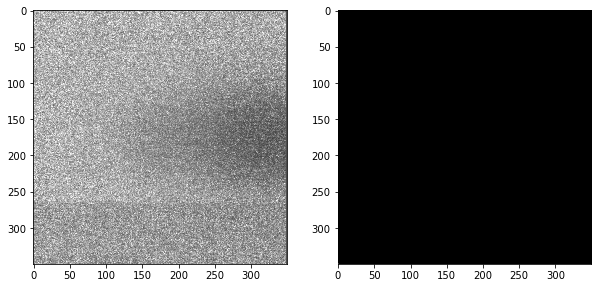

batch 2, corr -0.20000000000000018
1: pred_dist: [49.905468]


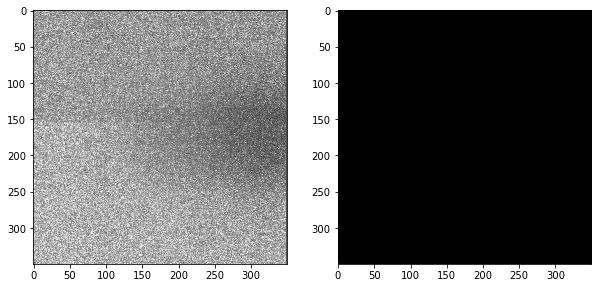

batch 1, corr -2.220446049250313e-16
1: pred_dist: [13.888379]


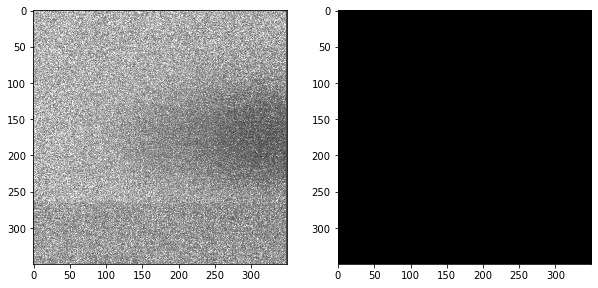

batch 2, corr -2.220446049250313e-16
1: pred_dist: [-2.573385]


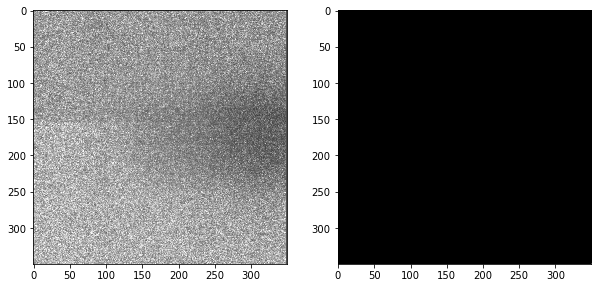

batch 1, corr 0.19999999999999973
1: pred_dist: [2.2339244]


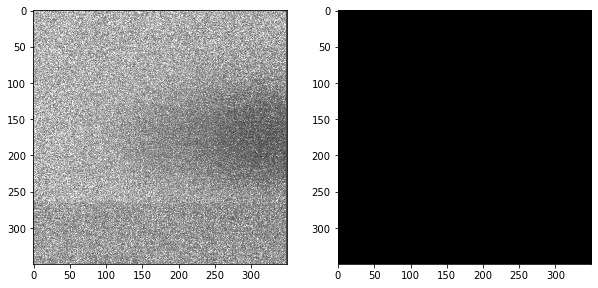

batch 2, corr 0.19999999999999973
1: pred_dist: [2.0321004]


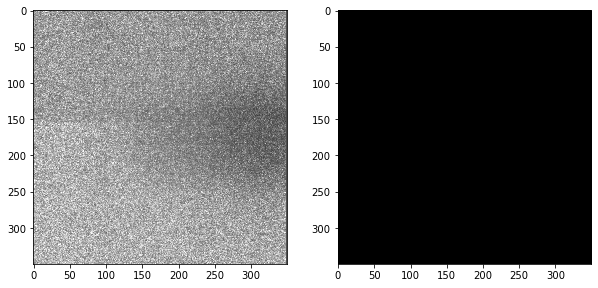

batch 1, corr 0.3999999999999997
1: pred_dist: [2.9142563]


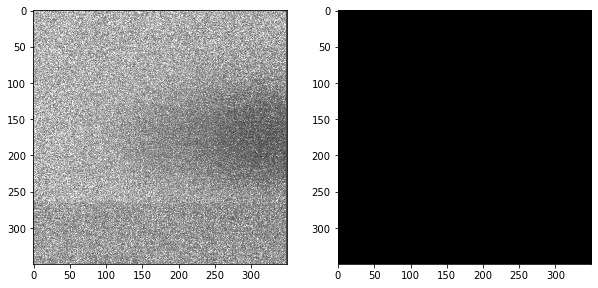

batch 2, corr 0.3999999999999997
1: pred_dist: [2.783894]


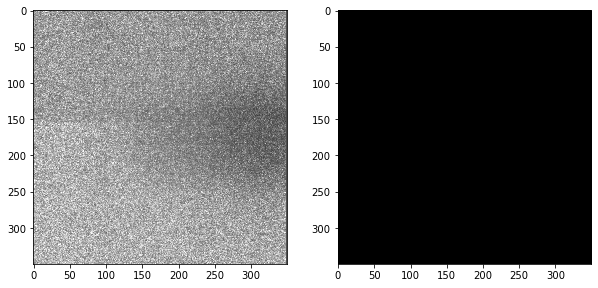

batch 1, corr 0.5999999999999996
1: pred_dist: [3.300792]


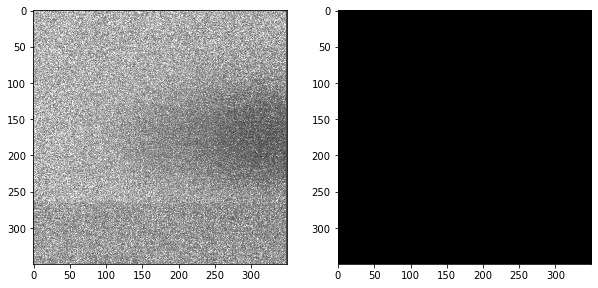

batch 2, corr 0.5999999999999996
1: pred_dist: [3.1575353]


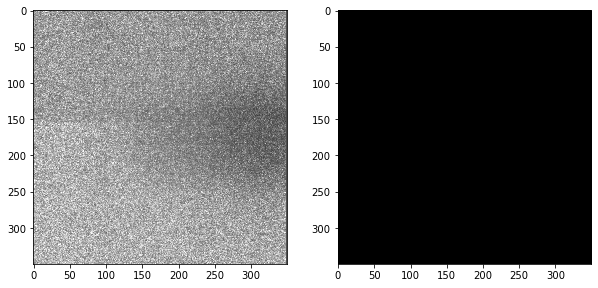

batch 1, corr 0.7999999999999996
1: pred_dist: [3.6982179]


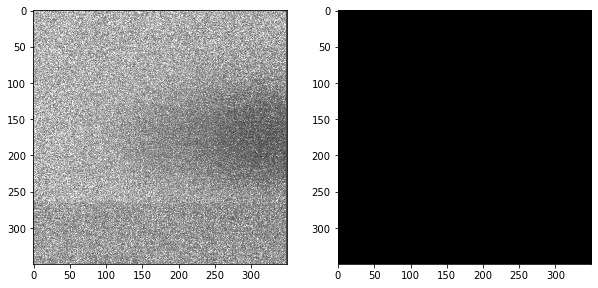

batch 2, corr 0.7999999999999996
1: pred_dist: [3.5482895]







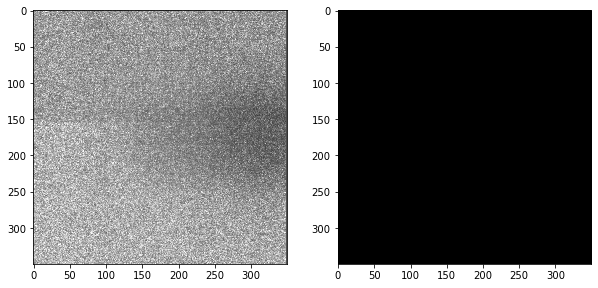

In [52]:
for corr in np.arange(-1,1, 0.2):
    for i, batch in tqdm(enumerate(data_loaders), total=data_lengths, desc="Batch"):
        true_images= batch["image"].float()/255.
        true_images[0]+=corr
        pred_masks, pred_dists = model(true_images.float().to(device))
        print("batch {}, corr {}".format(i + 1,corr))
        for j, (img, pr_msk, pr_dist) in enumerate(zip(true_images, pred_masks.cpu().detach().numpy(),
                                                                    pred_dists.cpu().detach().numpy())):
            print("{}: pred_dist: {}".format(j + 1, pr_dist))

            f = plt.figure(figsize=(10, 5))
            f.add_subplot(1, 2, 1)
            plt.imshow(img[0, ...], cmap='gray')
            f.add_subplot(1, 2, 2)
            plt.imshow(pr_msk[0, ...], cmap='gray')
            plt.show(block=True)

        if i ==1:
            break

batch 1
1: pred_dist: [356.1191]


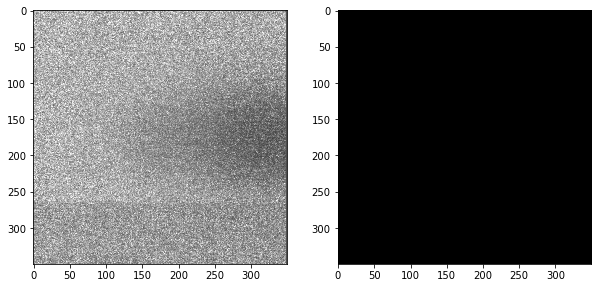

batch 2
1: pred_dist: [324.90063]


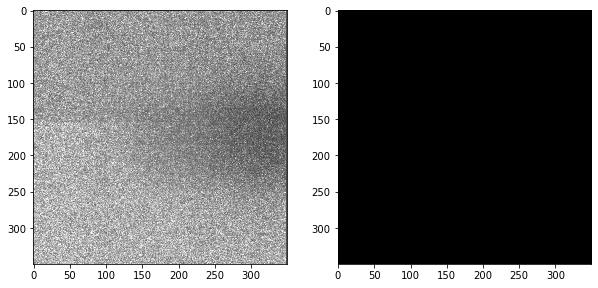

In [53]:
for i, batch in tqdm(enumerate(data_loaders), total=data_lengths // 16, desc="Batch"):

    true_images= batch["image"]
    pred_masks, pred_dists = model(true_images.float().to(device))
    print("batch {}".format(i + 1))
    for j, (img, pr_msk, pr_dist) in enumerate(zip(true_images, pred_masks.cpu().detach().numpy(),
                                                                    pred_dists.cpu().detach().numpy())):
        print("{}: pred_dist: {}".format(j + 1, pr_dist))

        f = plt.figure(figsize=(10, 5))
        f.add_subplot(1, 2, 1)
        plt.imshow(img[0, ...], cmap='gray')
        f.add_subplot(1, 2, 2)
        plt.imshow(pr_msk[0, ...], cmap='gray')
        plt.show(block=True)
        
    if i ==1:
        break

batch 1
1: pred_dist: [356.11914]


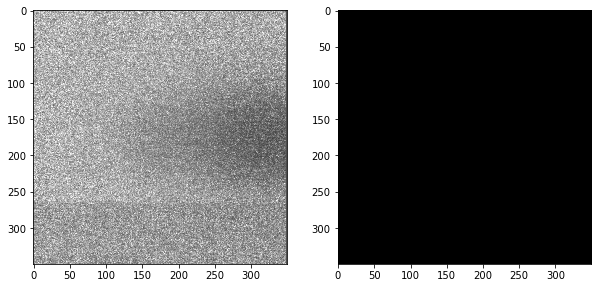

2: pred_dist: [324.90063]


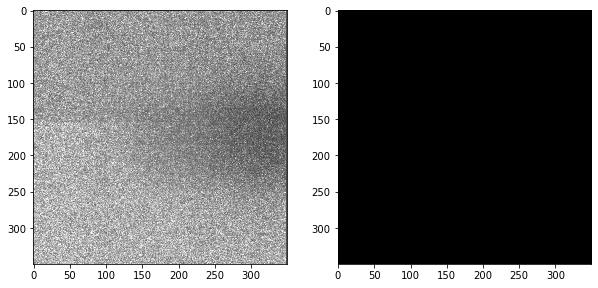

3: pred_dist: [348.35443]


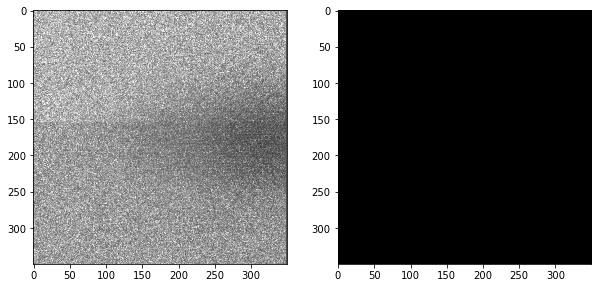

4: pred_dist: [342.44308]


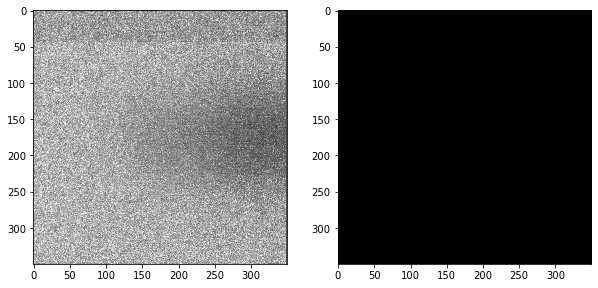

5: pred_dist: [329.10724]


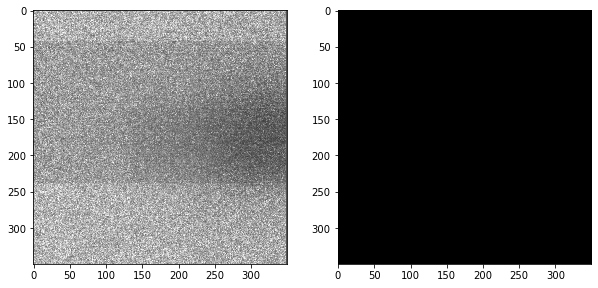

6: pred_dist: [357.99084]


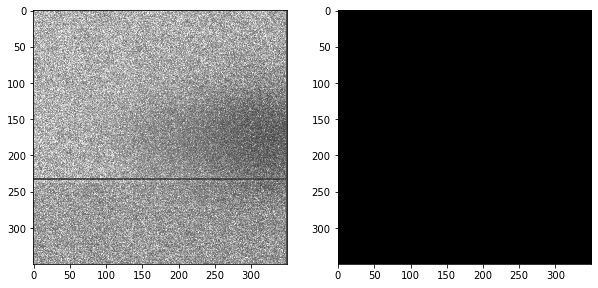

7: pred_dist: [327.11334]


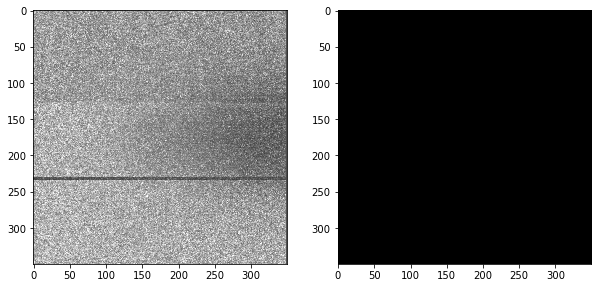

8: pred_dist: [346.21387]


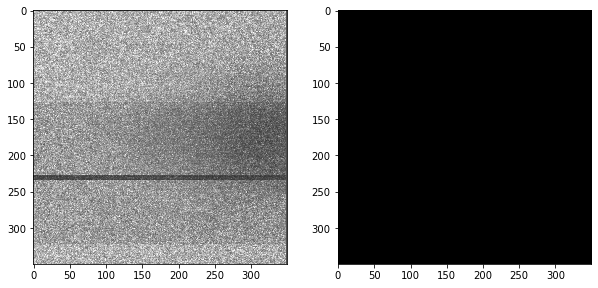

9: pred_dist: [347.2845]


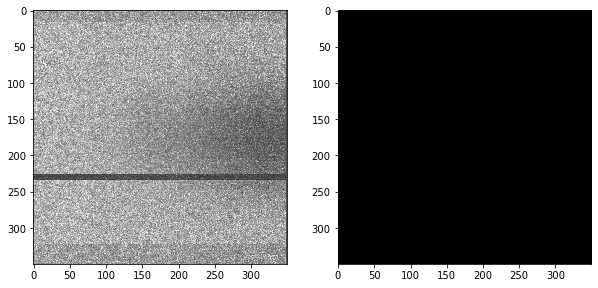

10: pred_dist: [319.8724]


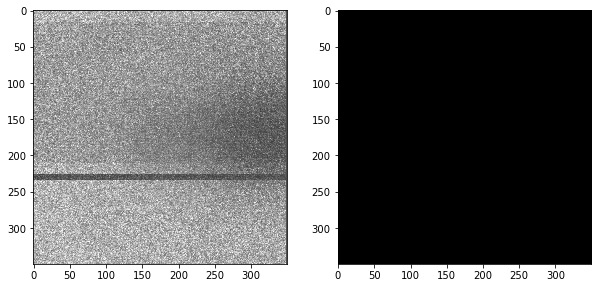

11: pred_dist: [353.86792]


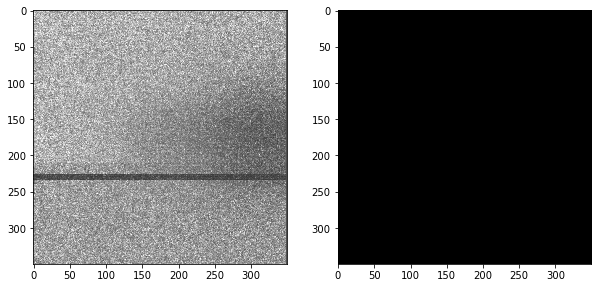

12: pred_dist: [329.0264]


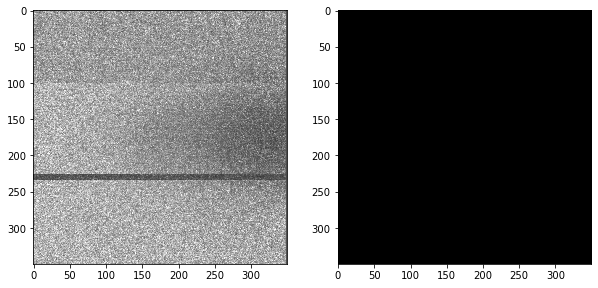

13: pred_dist: [346.70438]


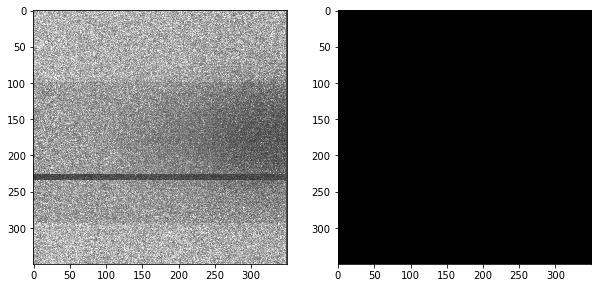

14: pred_dist: [351.79538]


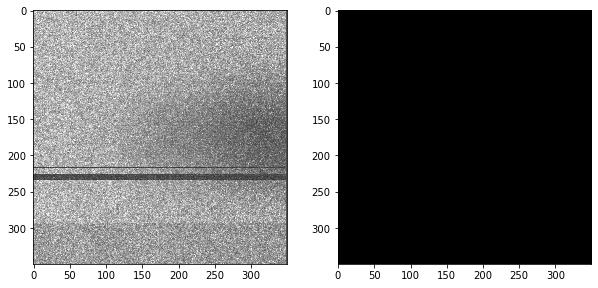

15: pred_dist: [322.12088]


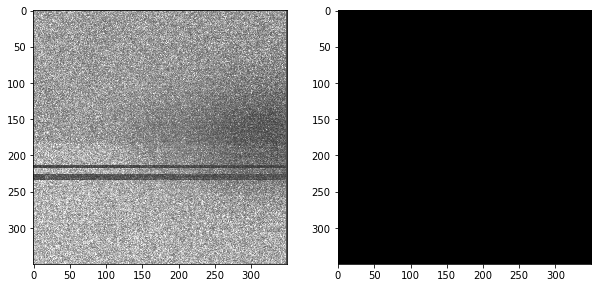

16: pred_dist: [349.3422]


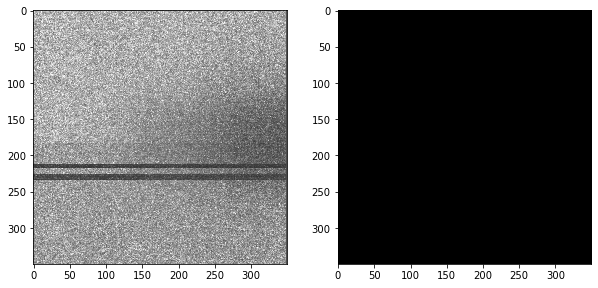

batch 2
1: pred_dist: [331.32626]


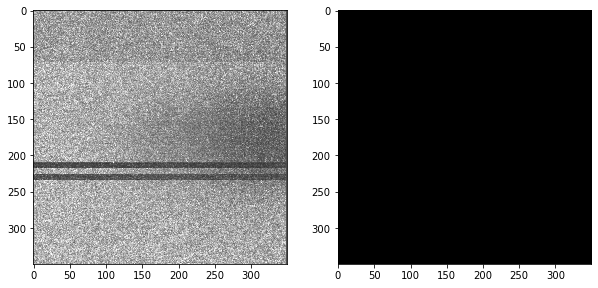

2: pred_dist: [337.77676]


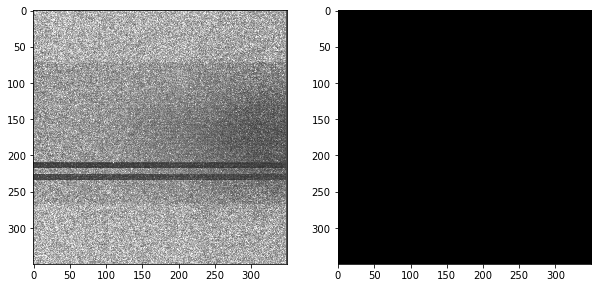

3: pred_dist: [353.06335]


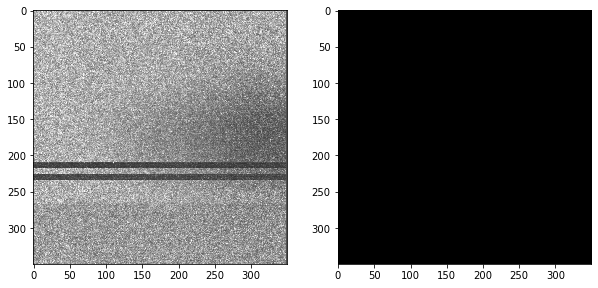

4: pred_dist: [324.78812]


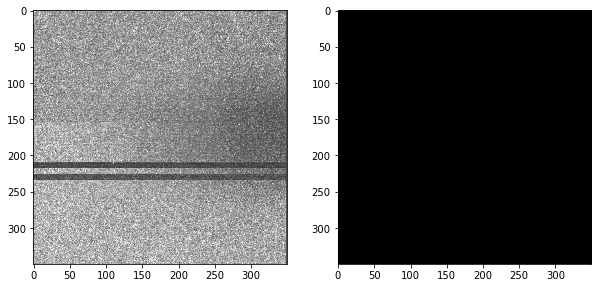

5: pred_dist: [343.22995]


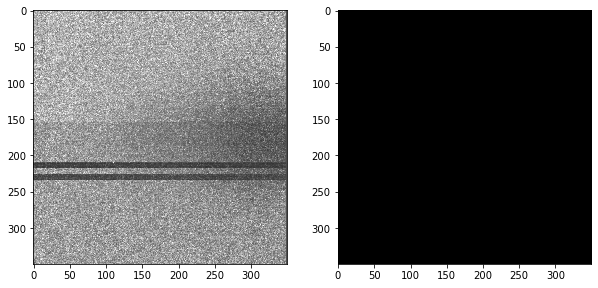

6: pred_dist: [340.6281]


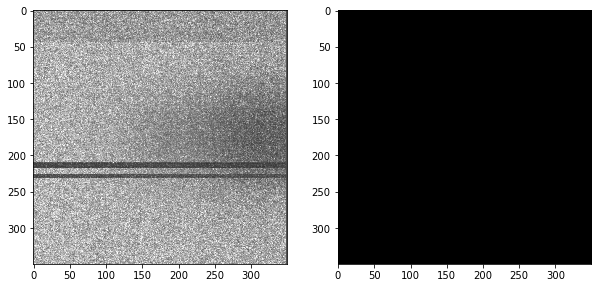

7: pred_dist: [326.84888]


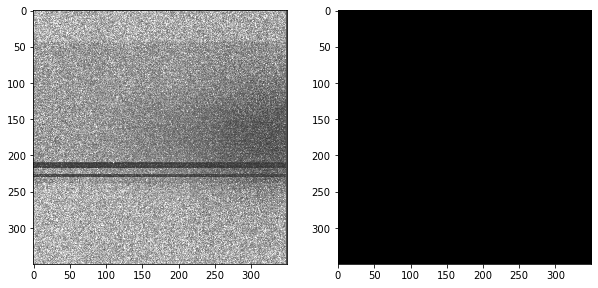

8: pred_dist: [357.58734]


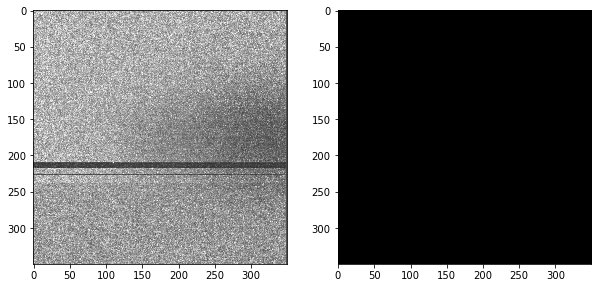

9: pred_dist: [328.99878]


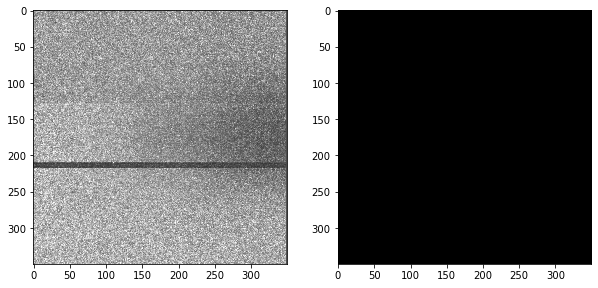

10: pred_dist: [348.21323]


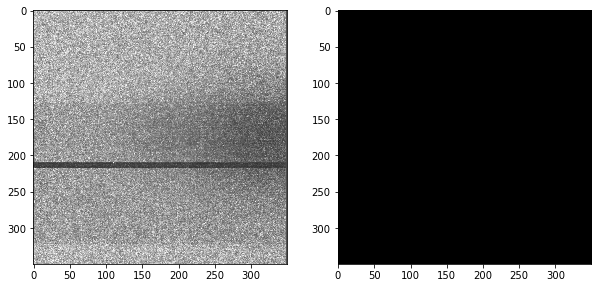

11: pred_dist: [348.69977]


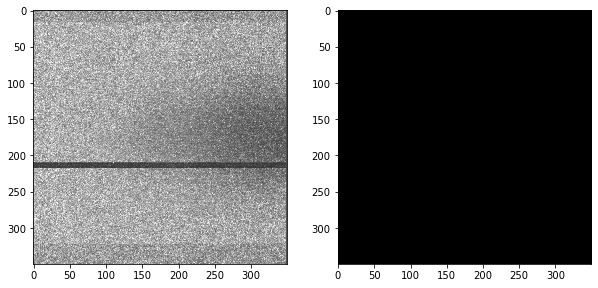

12: pred_dist: [319.75323]


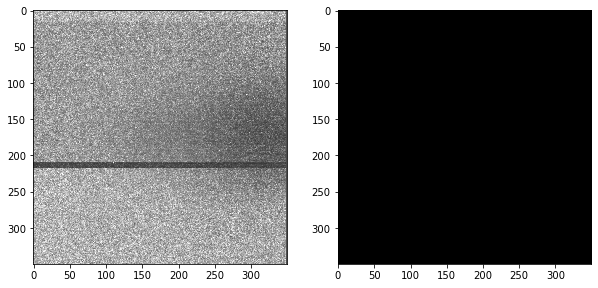

13: pred_dist: [356.39722]


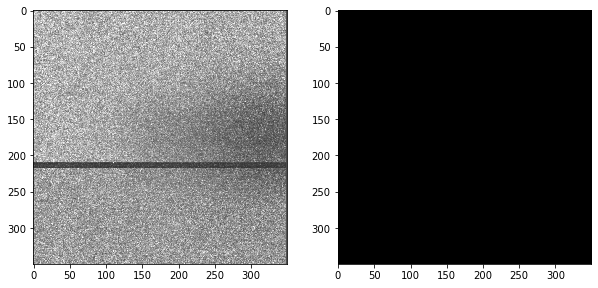

14: pred_dist: [328.3534]


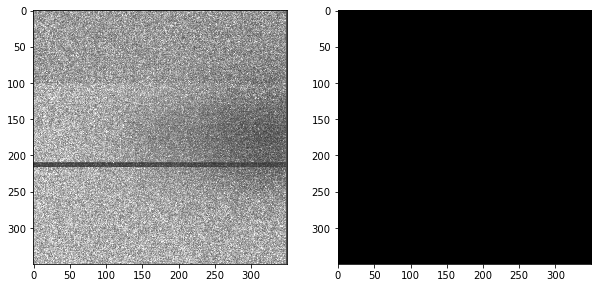

15: pred_dist: [346.65445]


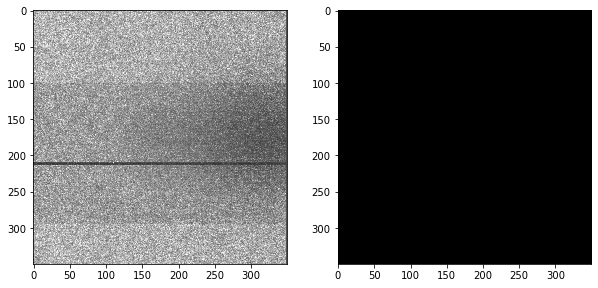

16: pred_dist: [350.6105]


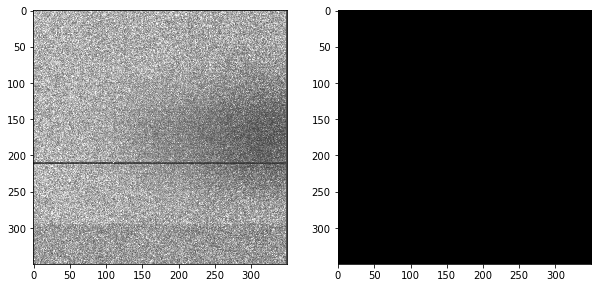

In [46]:
for i, batch in tqdm(enumerate(data_loaders), total=data_lengths // 16, desc="Batch"):

    true_images= batch["image"]
    pred_masks, pred_dists = model(true_images.float().to(device))
    print("batch {}".format(i + 1))
    for j, (img, pr_msk, pr_dist) in enumerate(zip(true_images, pred_masks.cpu().detach().numpy(),
                                                                    pred_dists.cpu().detach().numpy())):
        print("{}: pred_dist: {}".format(j + 1, pr_dist))

        f = plt.figure(figsize=(10, 5))
        f.add_subplot(1, 2, 1)
        plt.imshow(img[0, ...], cmap='gray')
        f.add_subplot(1, 2, 2)
        plt.imshow(pr_msk[0, ...], cmap='gray')
        plt.show(block=True)
        
    if i ==1:
        break

In [50]:
data_loaders, data_lengths = define_dataset(root_folder=root_folder_pos2_4, fname_key='File',alldata=True, load_mask=False)

batch 1
1: pred_dist: [338.3891]


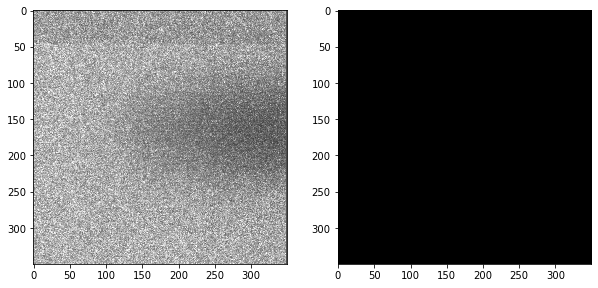

2: pred_dist: [326.5653]


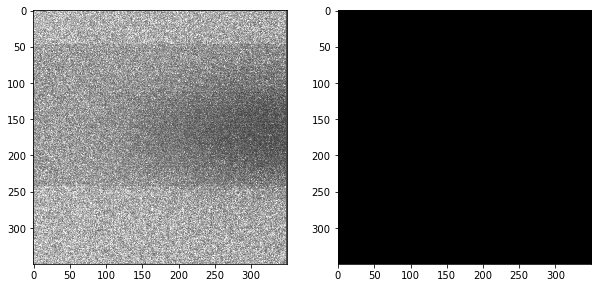

3: pred_dist: [357.30624]


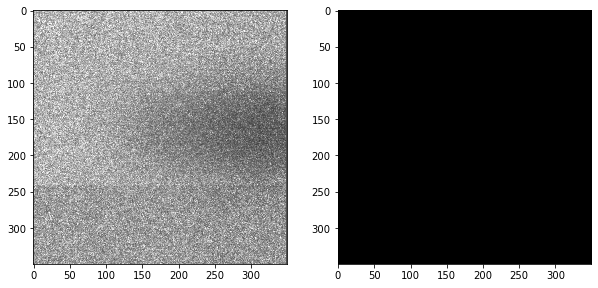

4: pred_dist: [322.84335]


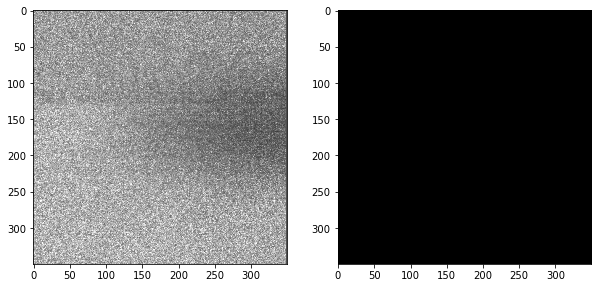

5: pred_dist: [342.68246]


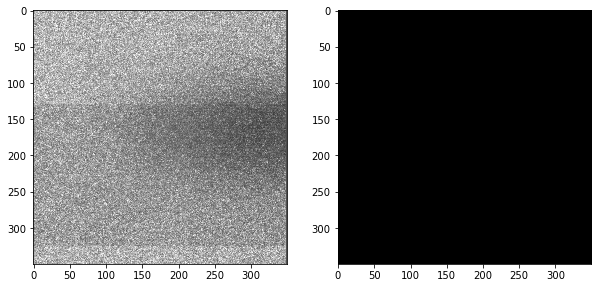

6: pred_dist: [345.3202]


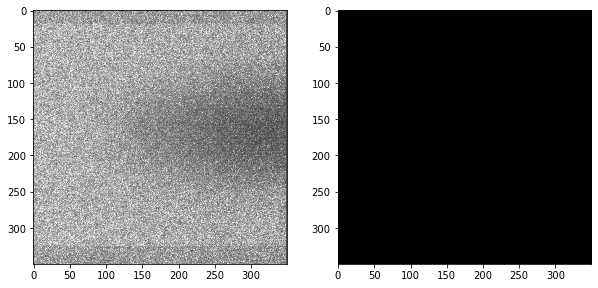

7: pred_dist: [315.3869]


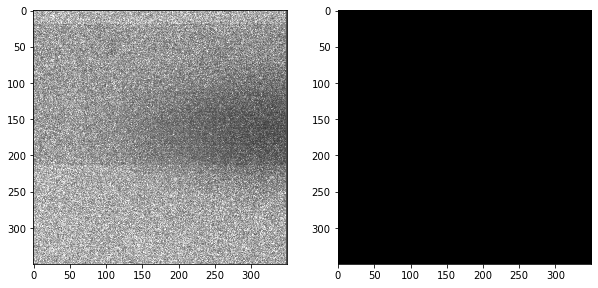

8: pred_dist: [351.46646]


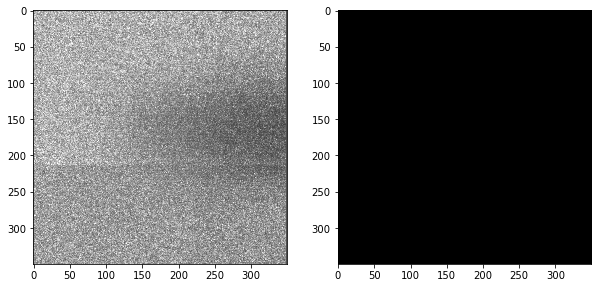

9: pred_dist: [321.53174]


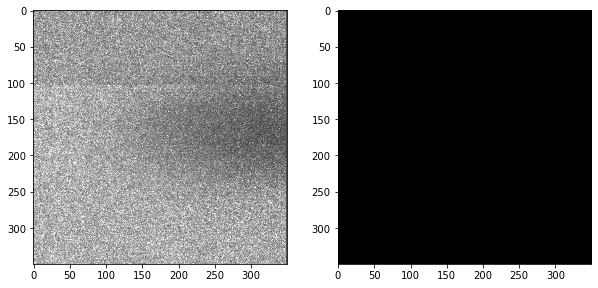

10: pred_dist: [340.26257]


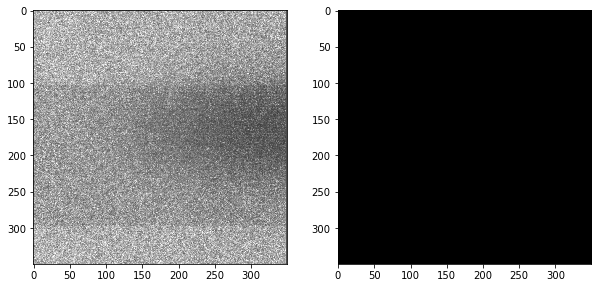

11: pred_dist: [346.9153]


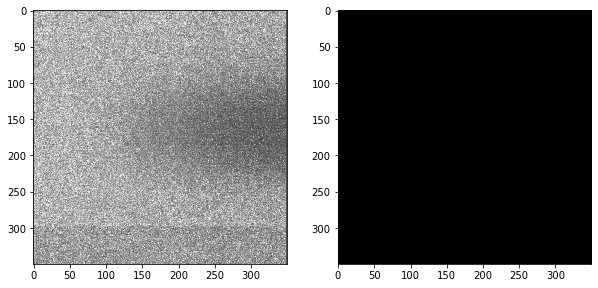

12: pred_dist: [319.3102]


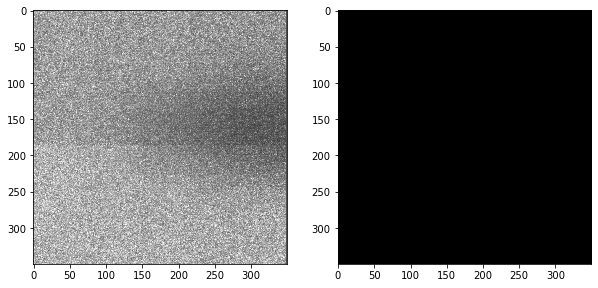

13: pred_dist: [348.4]


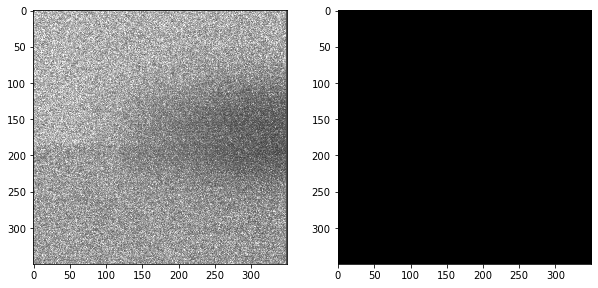

14: pred_dist: [328.448]


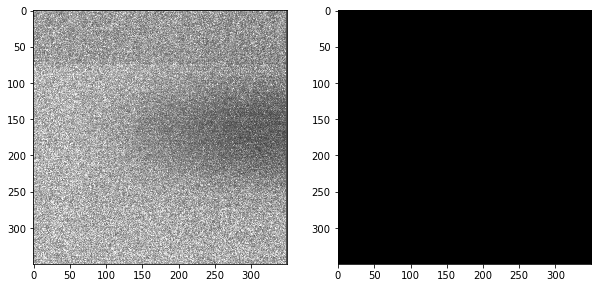

15: pred_dist: [336.45764]


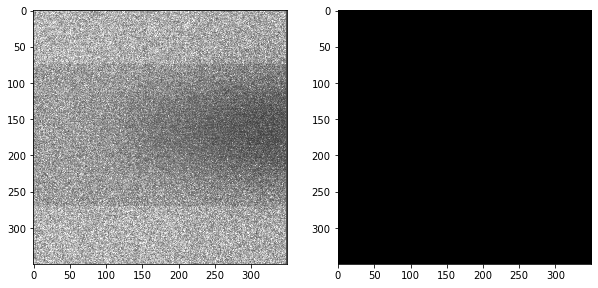

16: pred_dist: [350.07812]


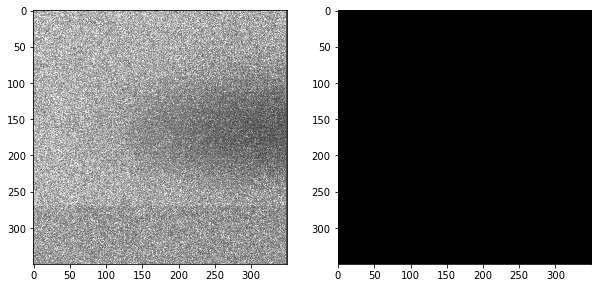

batch 2
1: pred_dist: [321.51755]


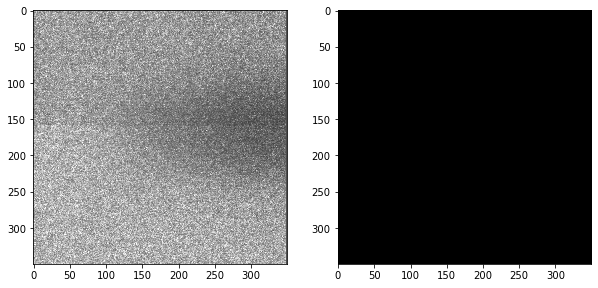

2: pred_dist: [343.2592]


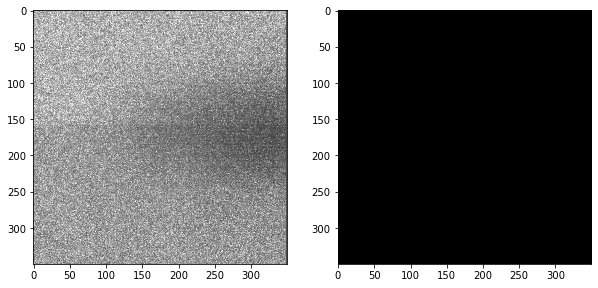

3: pred_dist: [335.25858]


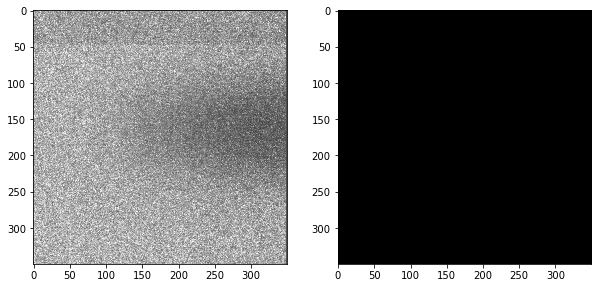

4: pred_dist: [324.33118]


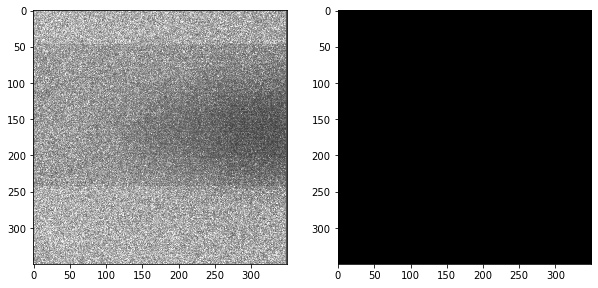

5: pred_dist: [353.36404]


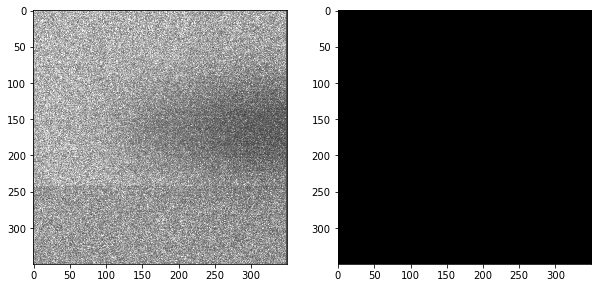

6: pred_dist: [324.39236]


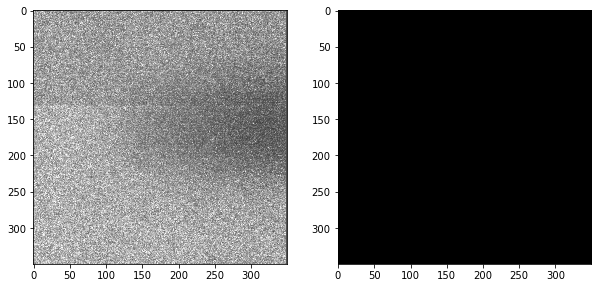

7: pred_dist: [341.34296]


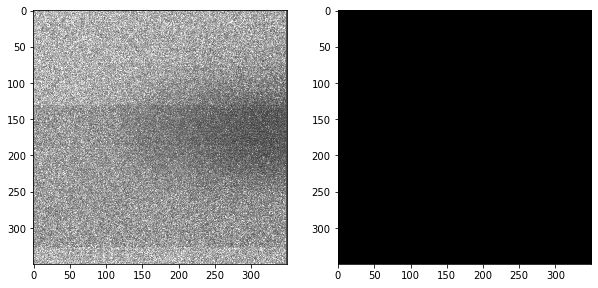

8: pred_dist: [344.87027]


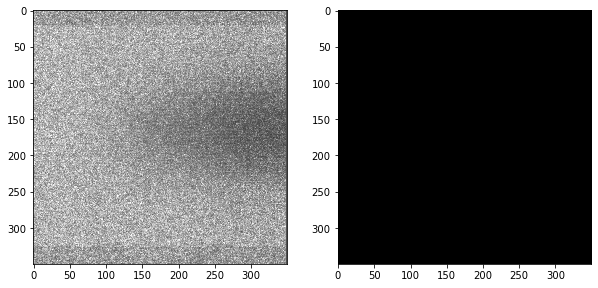

9: pred_dist: [316.14853]


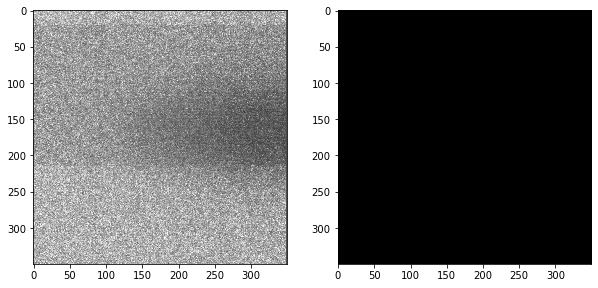

10: pred_dist: [352.64743]


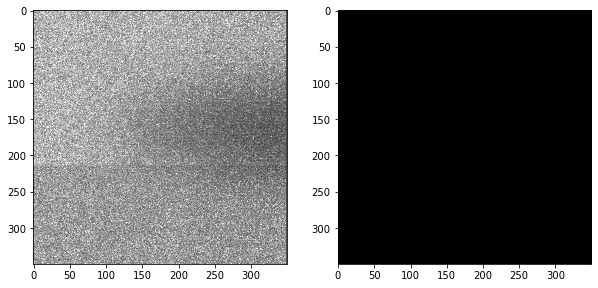

11: pred_dist: [324.52316]


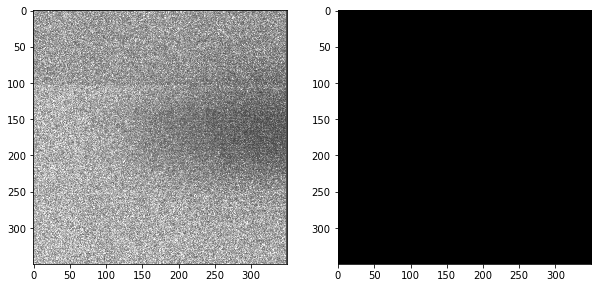

12: pred_dist: [341.78342]


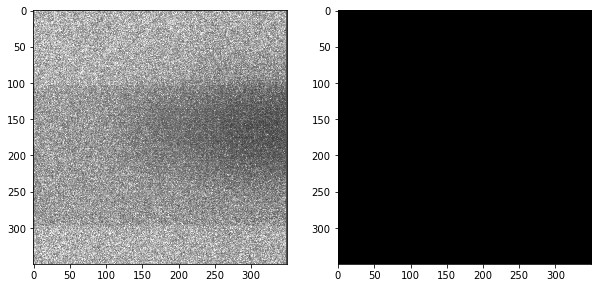

13: pred_dist: [345.75067]


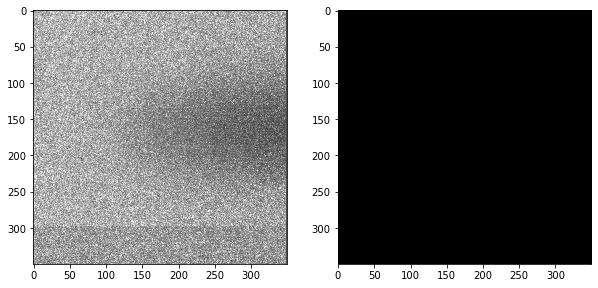

14: pred_dist: [316.77606]


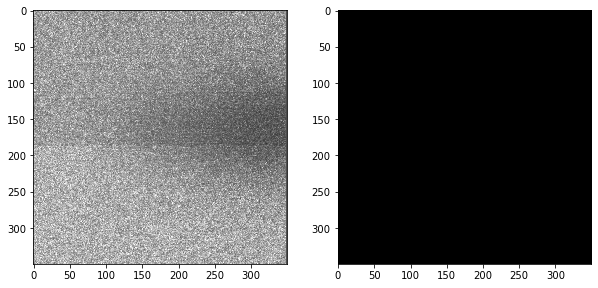

15: pred_dist: [347.28598]


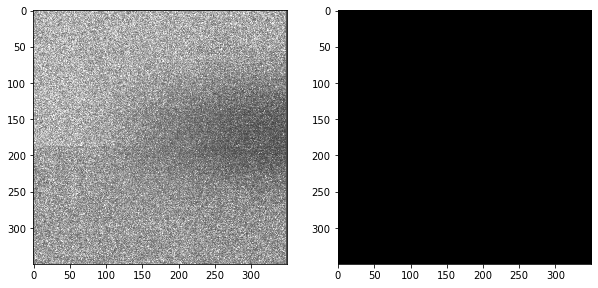

16: pred_dist: [325.6969]


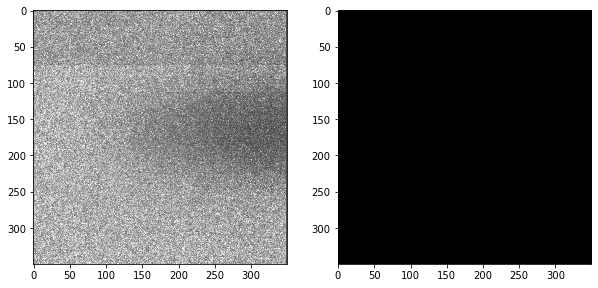

In [51]:
for i, batch in tqdm(enumerate(data_loaders), total=data_lengths // 16, desc="Batch"):

    true_images= batch["image"]
    pred_masks, pred_dists = model(true_images.float().to(device))
    print("batch {}".format(i + 1))
    for j, (img, pr_msk, pr_dist) in enumerate(zip(true_images, pred_masks.cpu().detach().numpy(),
                                                                    pred_dists.cpu().detach().numpy())):
        print("{}: pred_dist: {}".format(j + 1, pr_dist))

        f = plt.figure(figsize=(10, 5))
        f.add_subplot(1, 2, 1)
        plt.imshow(img[0, ...], cmap='gray')
        f.add_subplot(1, 2, 2)
        plt.imshow(pr_msk[0, ...], cmap='gray')
        plt.show(block=True)
        
    if i ==1:
        break

In [52]:
data_loaders, data_lengths = define_dataset(root_folder=root_folder_pos2_5, fname_key='File',alldata=True, load_mask=False)

batch 1
1: pred_dist: [359.9724]


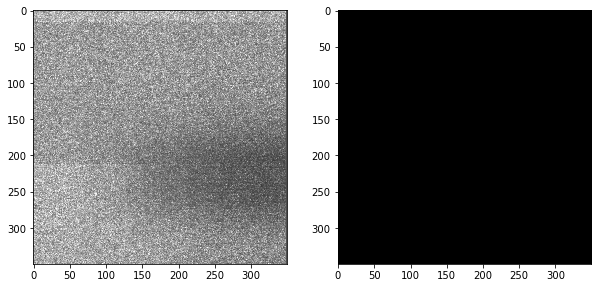

2: pred_dist: [392.6584]


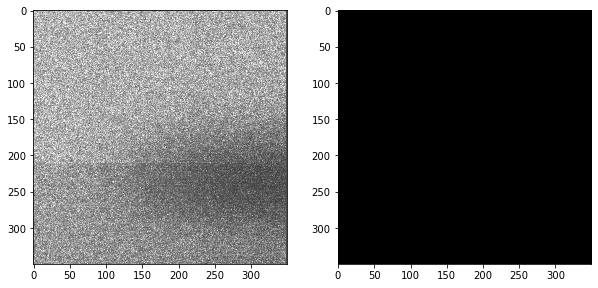

3: pred_dist: [372.91324]


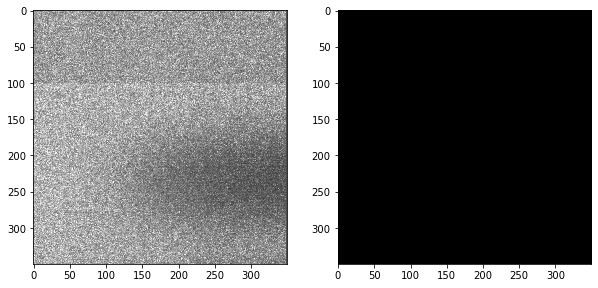

4: pred_dist: [381.34912]


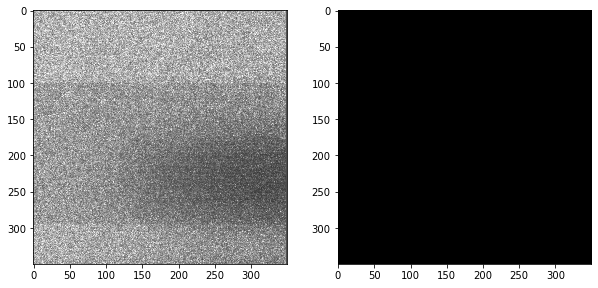

5: pred_dist: [394.67276]


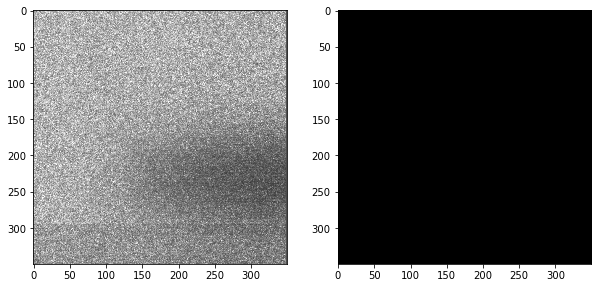

6: pred_dist: [361.11768]


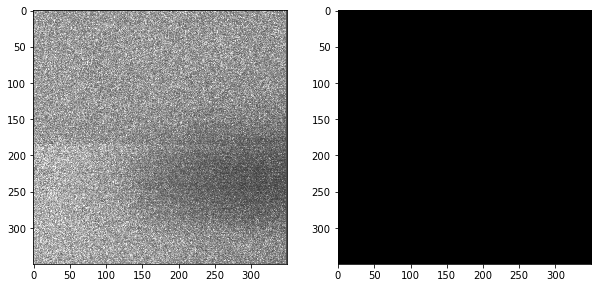

7: pred_dist: [385.20383]


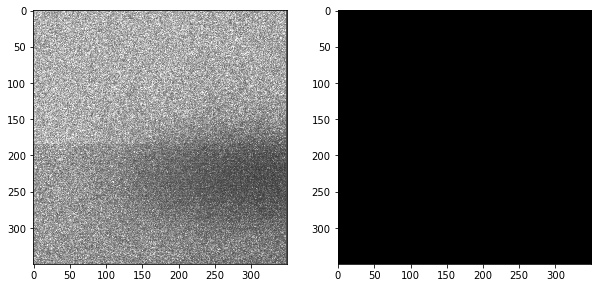

8: pred_dist: [374.67767]


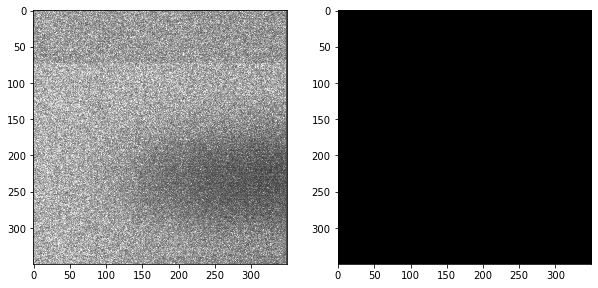

9: pred_dist: [373.10318]


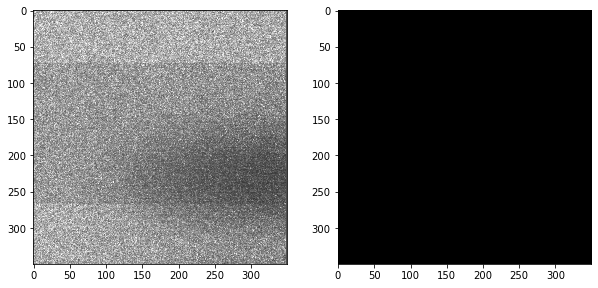

10: pred_dist: [391.90485]


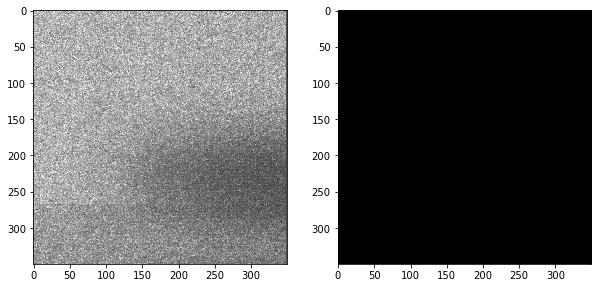

11: pred_dist: [364.62335]


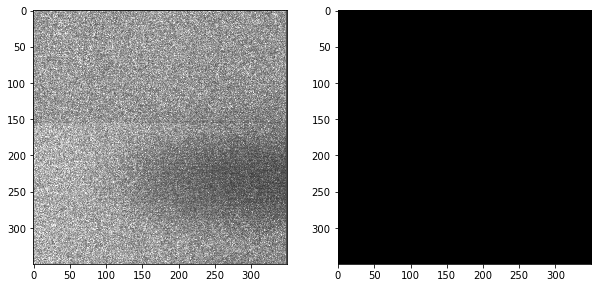

12: pred_dist: [382.1487]


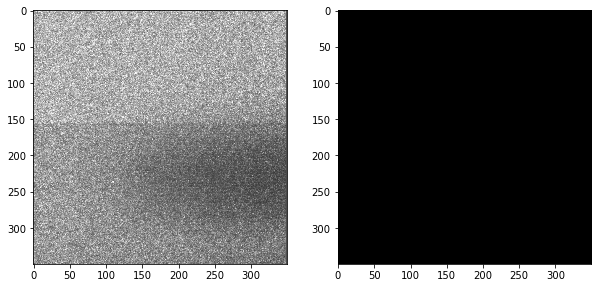

13: pred_dist: [387.18185]


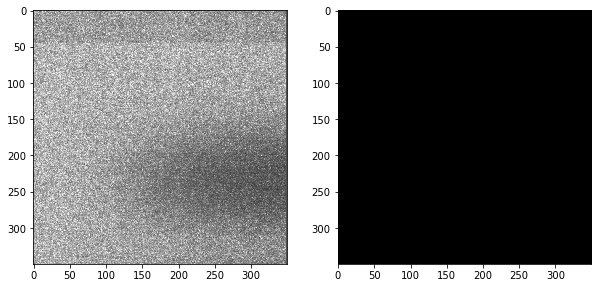

14: pred_dist: [369.70468]


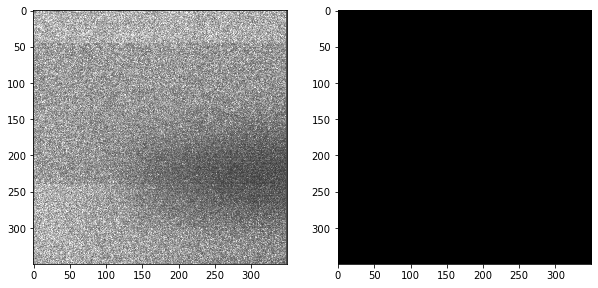

15: pred_dist: [397.46082]


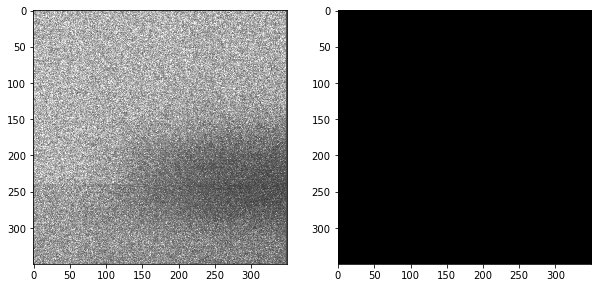

16: pred_dist: [367.1733]


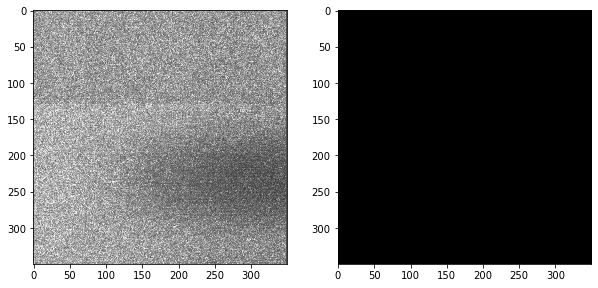

batch 2
1: pred_dist: [380.6308]


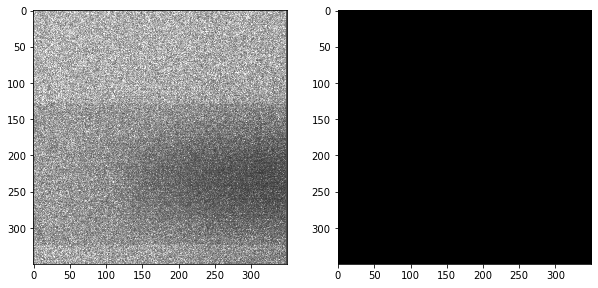

2: pred_dist: [389.55557]


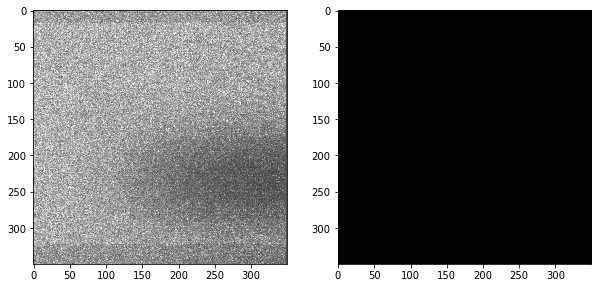

3: pred_dist: [356.09814]


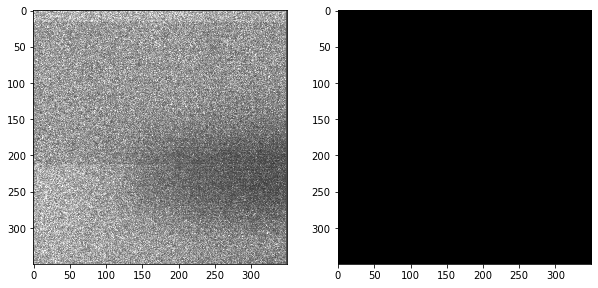

4: pred_dist: [391.1173]


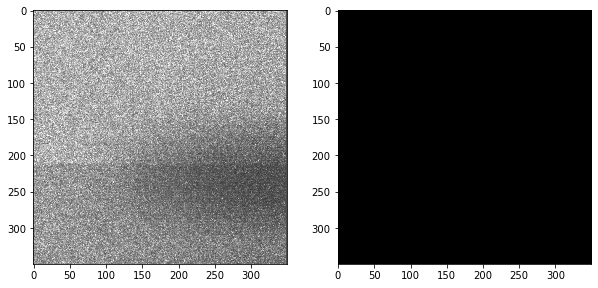

5: pred_dist: [366.21048]


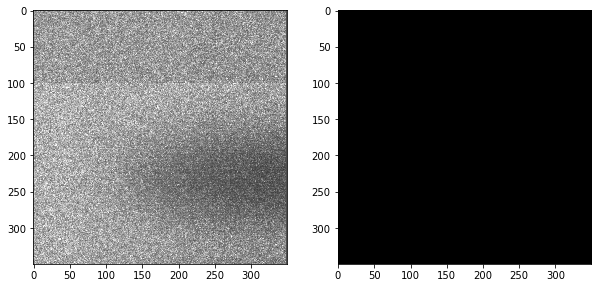

6: pred_dist: [381.42816]


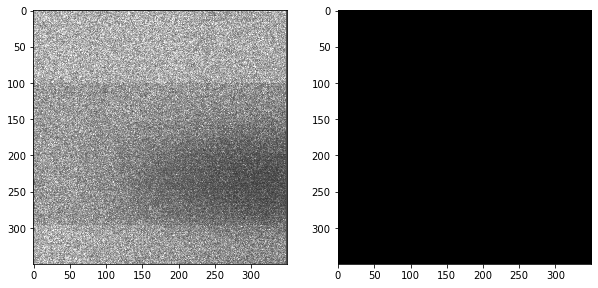

7: pred_dist: [392.67157]


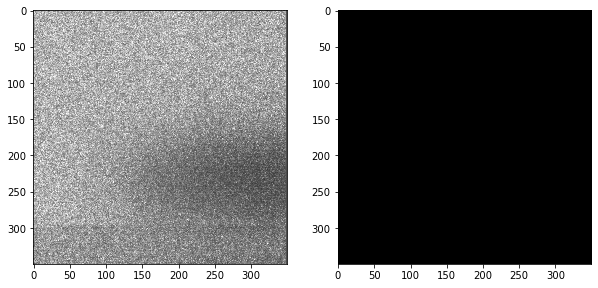

8: pred_dist: [360.6638]


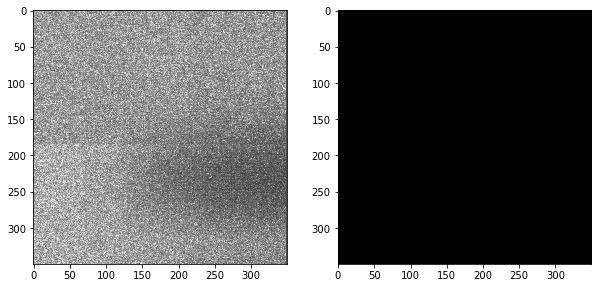

9: pred_dist: [387.0276]


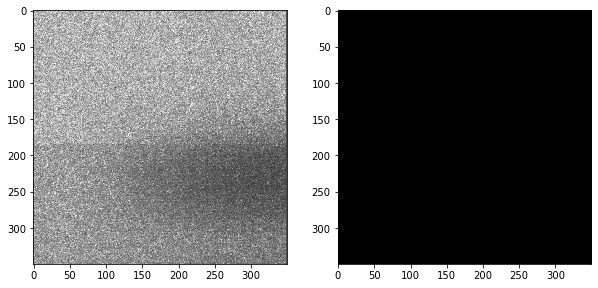

10: pred_dist: [372.55374]


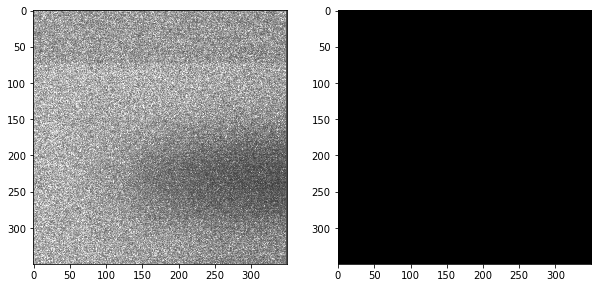

11: pred_dist: [376.77298]


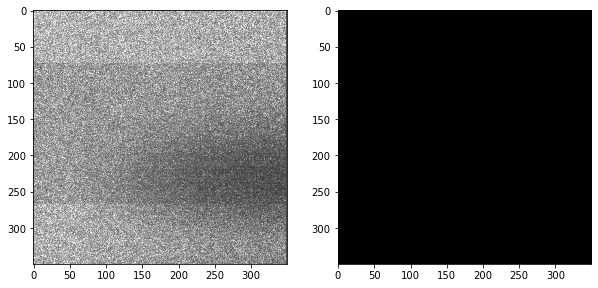

12: pred_dist: [393.23236]


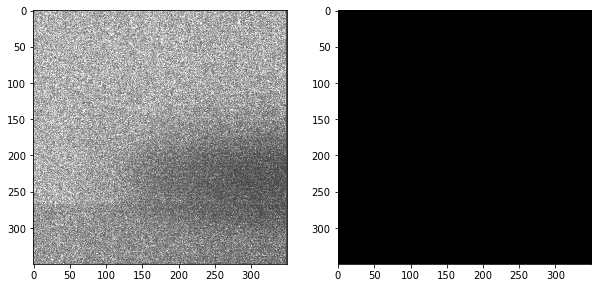

13: pred_dist: [365.53976]


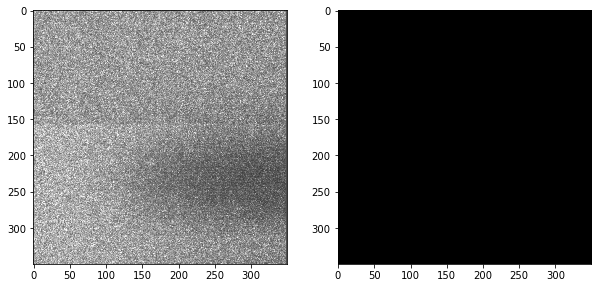

14: pred_dist: [382.5496]


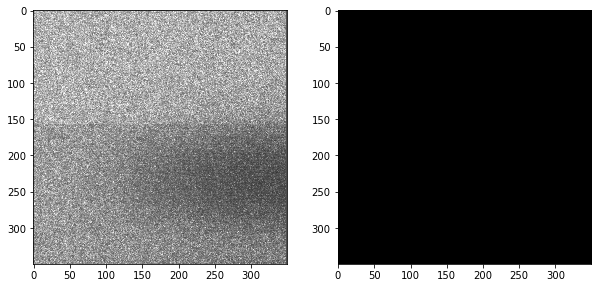

15: pred_dist: [384.10117]


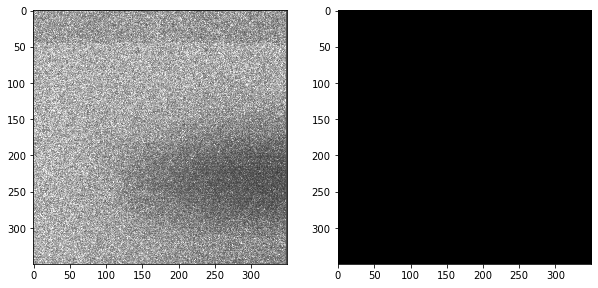

16: pred_dist: [366.13077]


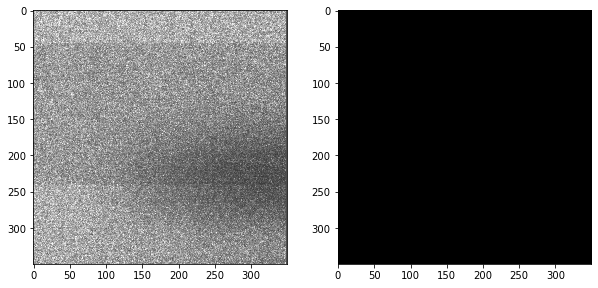

In [53]:
for i, batch in tqdm(enumerate(data_loaders), total=data_lengths // 16, desc="Batch"):

    true_images= batch["image"]
    pred_masks, pred_dists = model(true_images.float().to(device))
    print("batch {}".format(i + 1))
    for j, (img, pr_msk, pr_dist) in enumerate(zip(true_images, pred_masks.cpu().detach().numpy(),
                                                                    pred_dists.cpu().detach().numpy())):
        print("{}: pred_dist: {}".format(j + 1, pr_dist))

        f = plt.figure(figsize=(10, 5))
        f.add_subplot(1, 2, 1)
        plt.imshow(img[0, ...], cmap='gray')
        f.add_subplot(1, 2, 2)
        plt.imshow(pr_msk[0, ...], cmap='gray')
        plt.show(block=True)
        
    if i ==1:
        break

In [27]:
data_loaders, data_lengths = define_dataset(root_folder=root_folder_pos2_6, fname_key='File',alldata=True, 
                                            batch_size=1, load_mask=False)

batch 1
1: pred_dist: [300.84204]


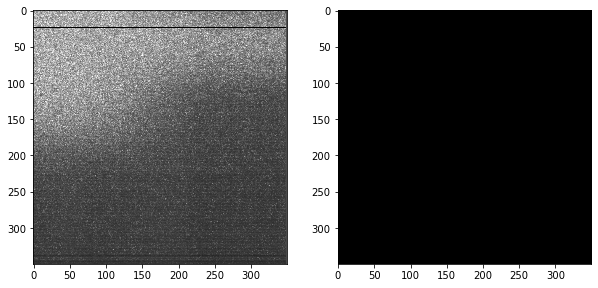

2: pred_dist: [278.76154]


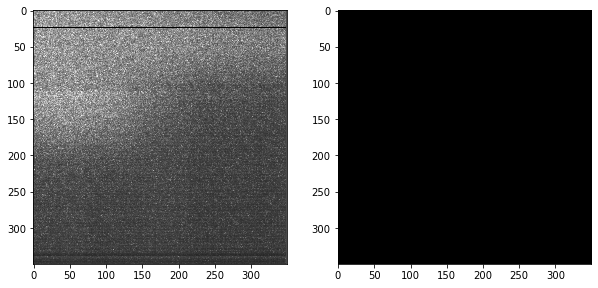

3: pred_dist: [297.40585]


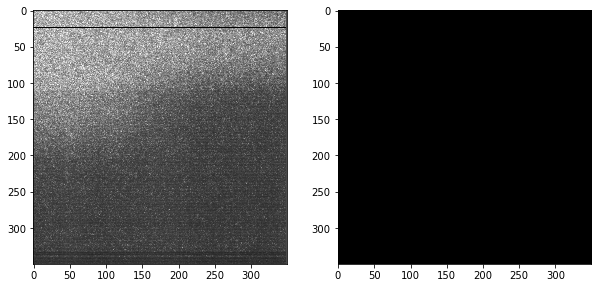

4: pred_dist: [299.75027]


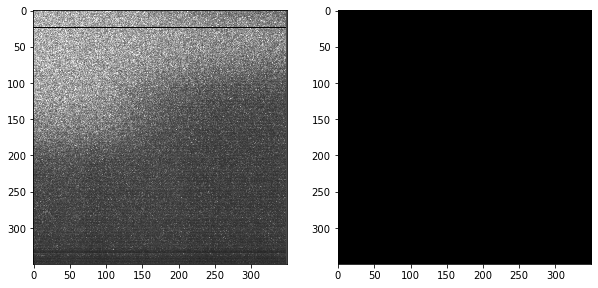

5: pred_dist: [275.74216]


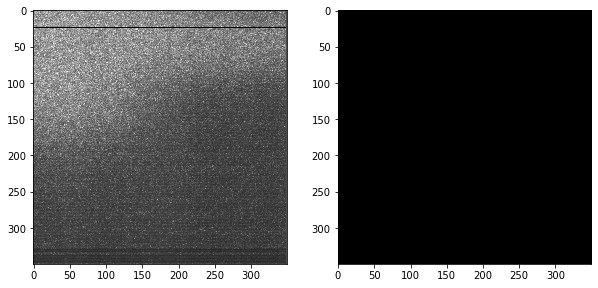

6: pred_dist: [300.6287]


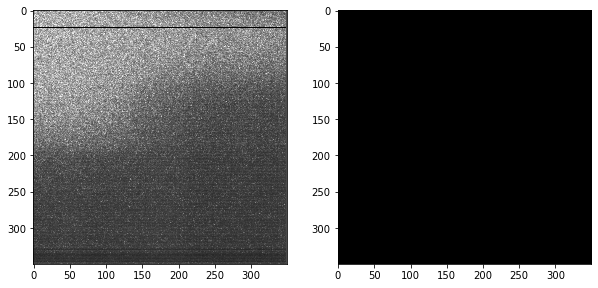

7: pred_dist: [279.00073]


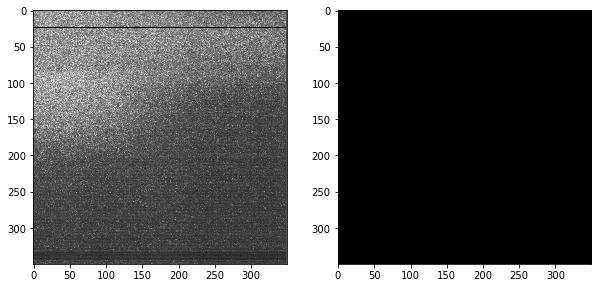

8: pred_dist: [293.081]


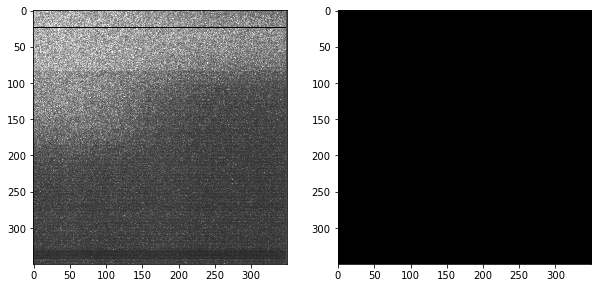

9: pred_dist: [298.6762]


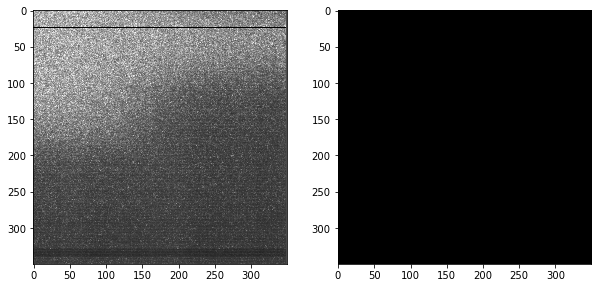

10: pred_dist: [272.90335]


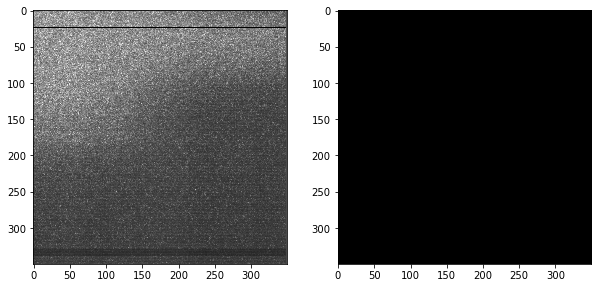

11: pred_dist: [296.25284]


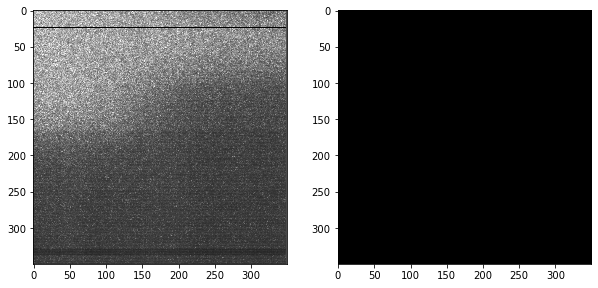

12: pred_dist: [285.79193]


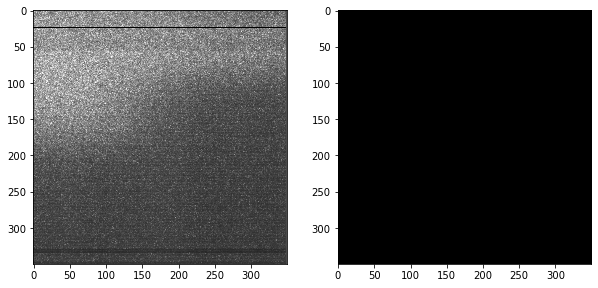

13: pred_dist: [288.5614]


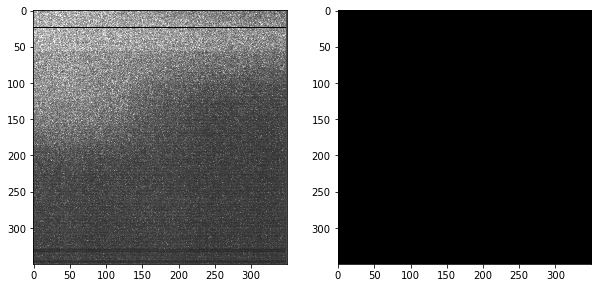

14: pred_dist: [303.07333]


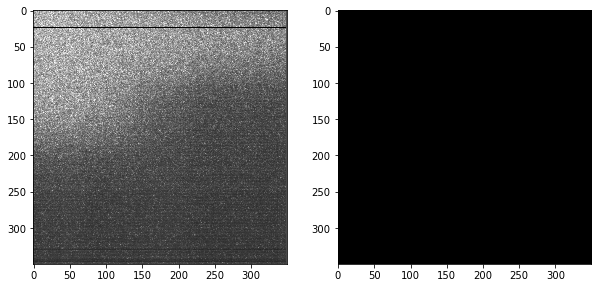

15: pred_dist: [279.02072]


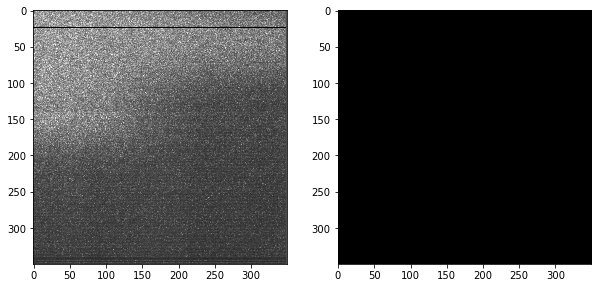

16: pred_dist: [294.4932]


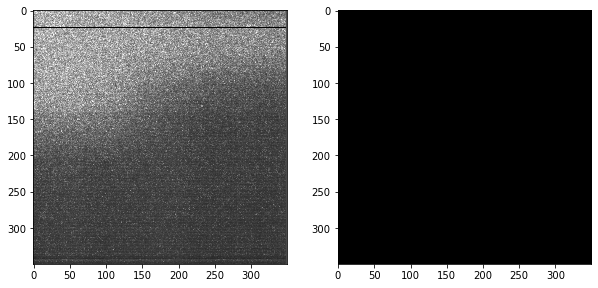

batch 2
1: pred_dist: [296.74832]


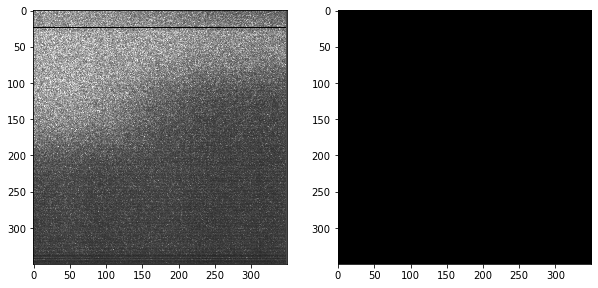

2: pred_dist: [275.61584]


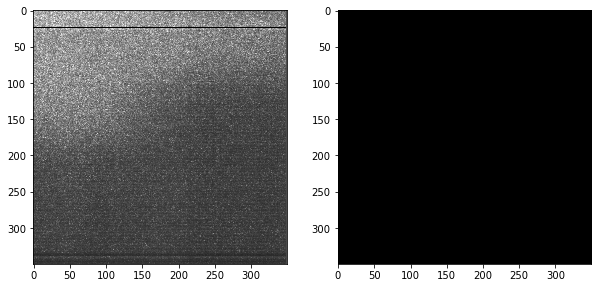

3: pred_dist: [298.13693]


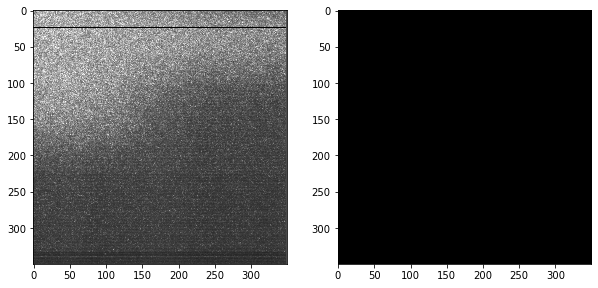

4: pred_dist: [276.86923]


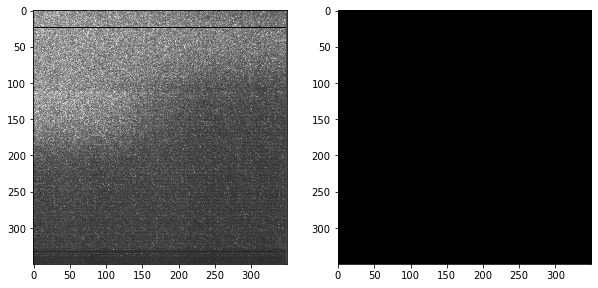

5: pred_dist: [292.09836]


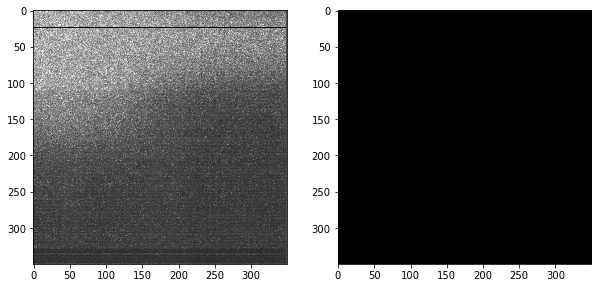

6: pred_dist: [301.15976]


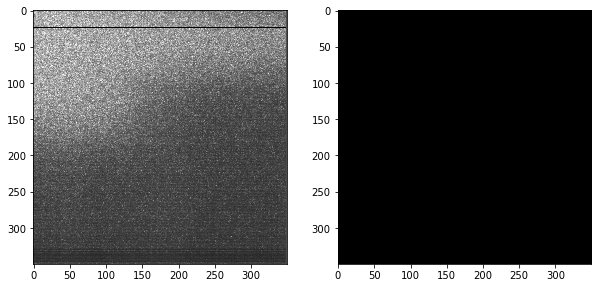

7: pred_dist: [271.18622]


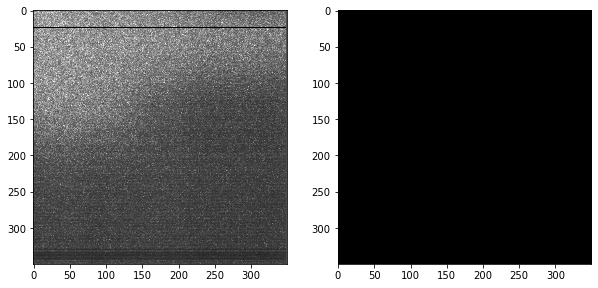

8: pred_dist: [299.2455]


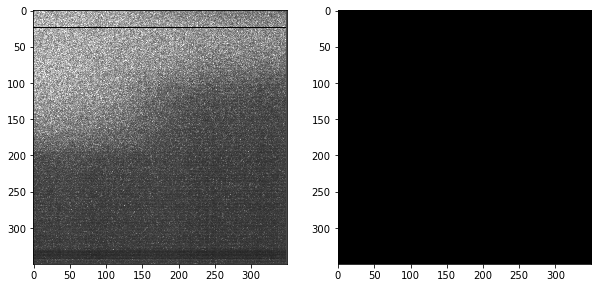

9: pred_dist: [280.03494]


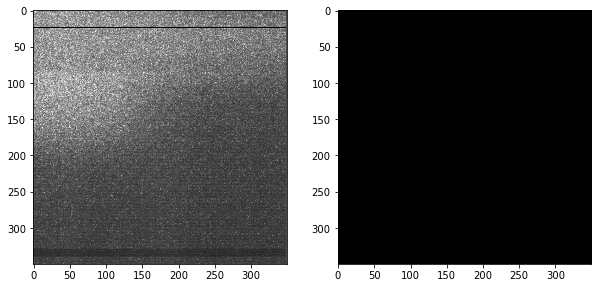

10: pred_dist: [293.09622]


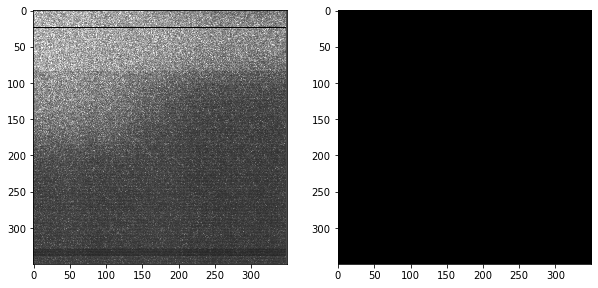

11: pred_dist: [302.5666]


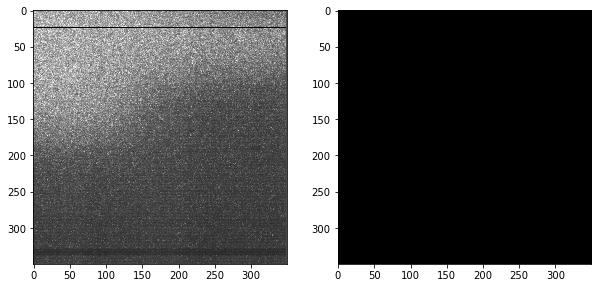

12: pred_dist: [273.18643]


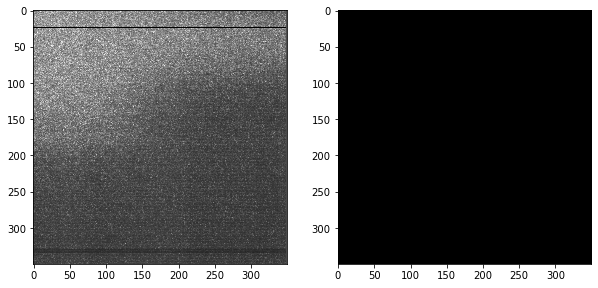

13: pred_dist: [296.41397]


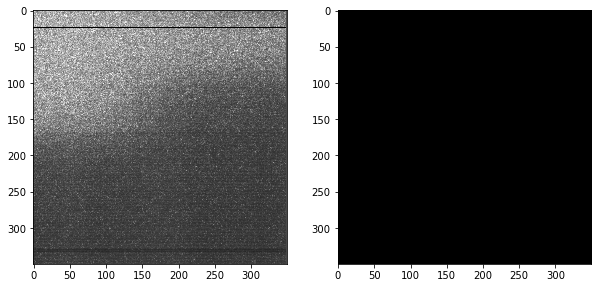

14: pred_dist: [286.4032]


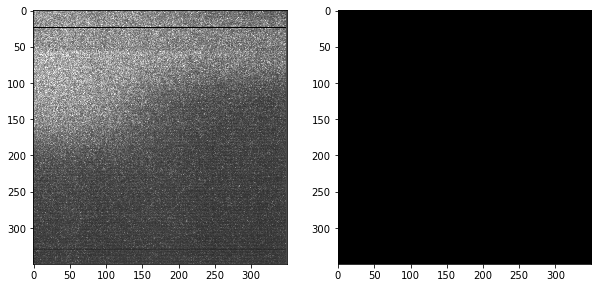

15: pred_dist: [287.34302]


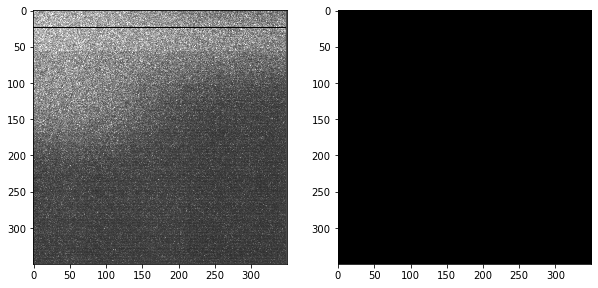

16: pred_dist: [300.98737]


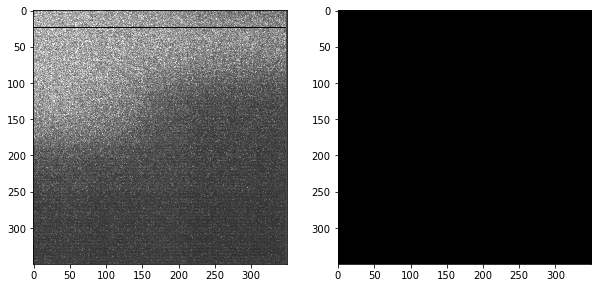

In [55]:
for i, batch in tqdm(enumerate(data_loaders), total=data_lengths // 16, desc="Batch"):

    true_images= batch["image"]
    pred_masks, pred_dists = model(true_images.float().to(device))
    print("batch {}".format(i + 1))
    for j, (img, pr_msk, pr_dist) in enumerate(zip(true_images, pred_masks.cpu().detach().numpy(),
                                                                    pred_dists.cpu().detach().numpy())):
        print("{}: pred_dist: {}".format(j + 1, pr_dist))

        f = plt.figure(figsize=(10, 5))
        f.add_subplot(1, 2, 1)
        plt.imshow(img[0, ...], cmap='gray')
        f.add_subplot(1, 2, 2)
        plt.imshow(pr_msk[0, ...], cmap='gray')
        plt.show(block=True)
        
    if i ==1:
        break

In [ ]:
data_loaders, data_lengths = define_dataset(root_folder=root_folder_pos2_4, fname_key='File',alldata=True, load_mask=False,)

In [54]:
root_folder_inv = '/storage/yw18581/data/test_inv/'

In [55]:
from core.utils.data import define_dataset, select_dist

In [57]:
data_loaders, data_lengths = define_dataset(root_folder=root_folder_inv, fname_key='File',alldata=True, 
                                            batch_size=1, 
                                            load_mask=False, row_slice=slice(0, 1400), col_slice= slice(1000, None))

batch 1
1: pred_dist: [2.048449]


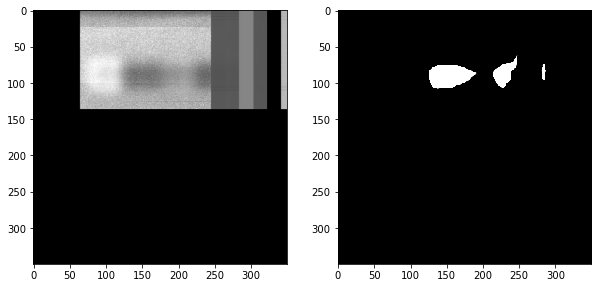

batch 2
1: pred_dist: [1.8796928]


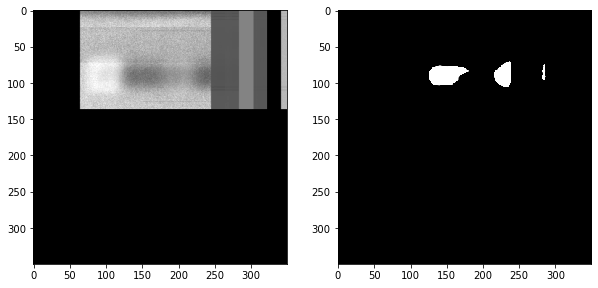

In [59]:
for i, batch in tqdm(enumerate(data_loaders), total=data_lengths, desc="Batch"):

    true_images= batch["image"]
    pred_masks, pred_dists = model(true_images.float().to(device))
    print("batch {}".format(i + 1))
    for j, (img, pr_msk, pr_dist) in enumerate(zip(true_images, pred_masks.cpu().detach().numpy(),
                                                                    pred_dists.cpu().detach().numpy())):
        print("{}: pred_dist: {}".format(j + 1, pr_dist))

        f = plt.figure(figsize=(10, 5))
        f.add_subplot(1, 2, 1)
        plt.imshow(img[0, ...], cmap='gray')
        f.add_subplot(1, 2, 2)
        plt.imshow(pr_msk[0, ...], cmap='gray')
        plt.show(block=True)
        
    if i ==1:
        break

batch 1
1: pred_dist: [30.408268]


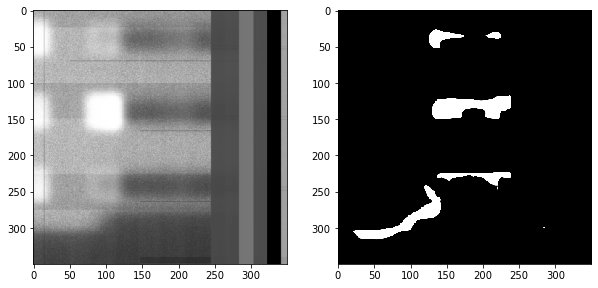

2: pred_dist: [28.111116]


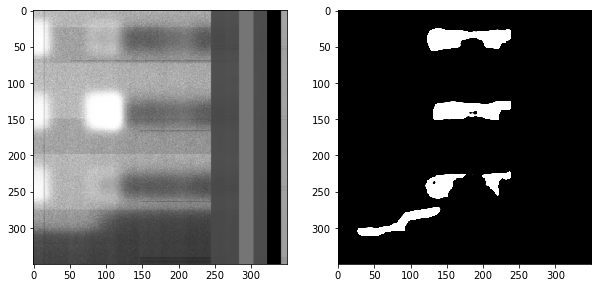

3: pred_dist: [30.138662]


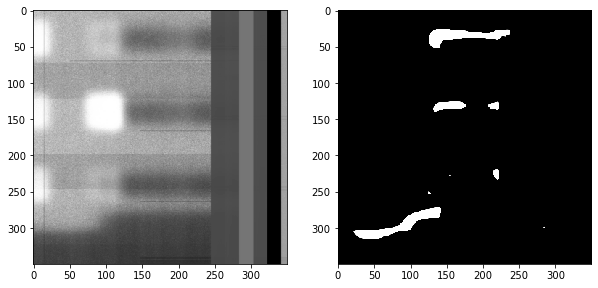

4: pred_dist: [29.29359]


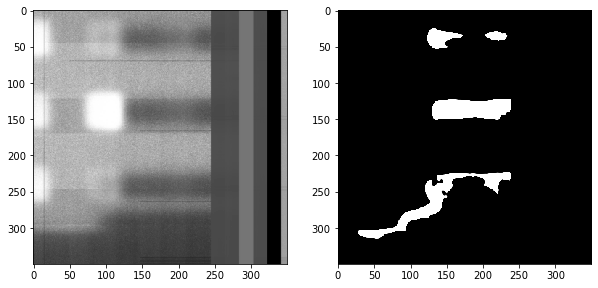

5: pred_dist: [29.217264]


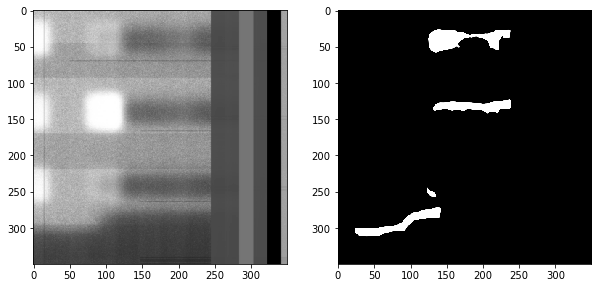

6: pred_dist: [30.128265]


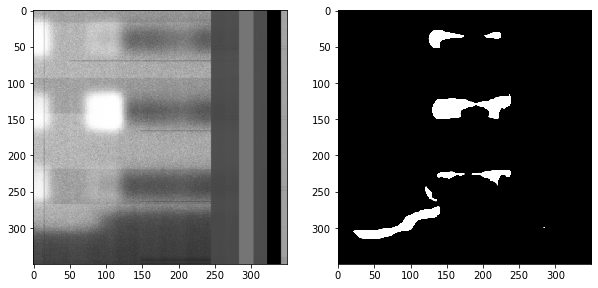

7: pred_dist: [28.481192]


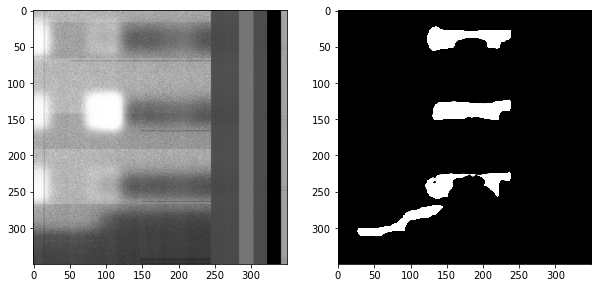

8: pred_dist: [30.334146]


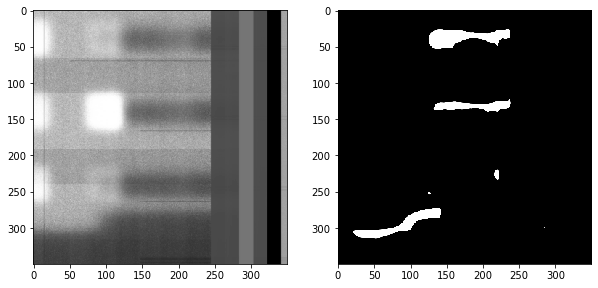

9: pred_dist: [29.959782]


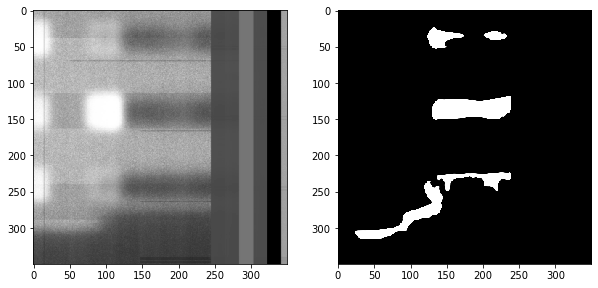

10: pred_dist: [28.639318]


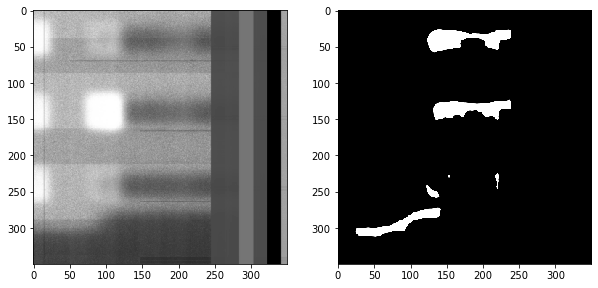

11: pred_dist: [30.28606]


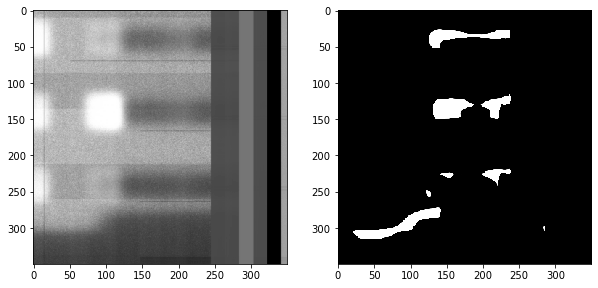

12: pred_dist: [28.260447]


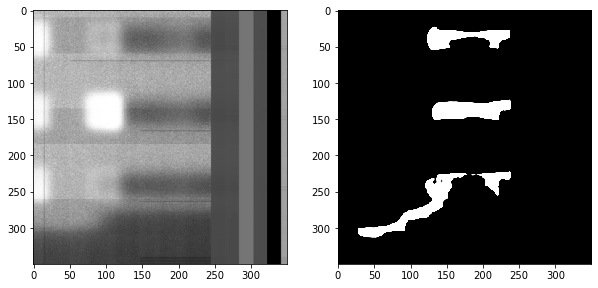

13: pred_dist: [30.01879]


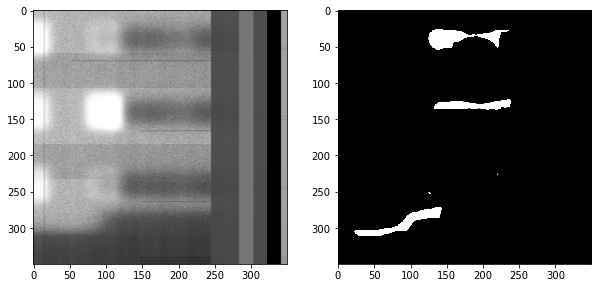

14: pred_dist: [30.291624]


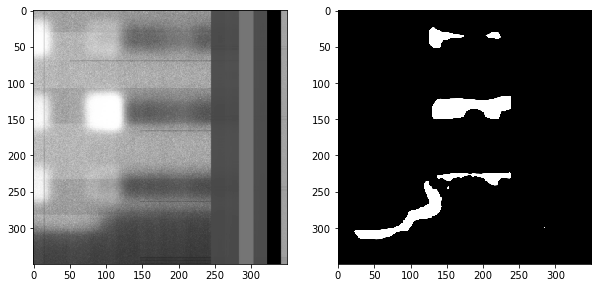

15: pred_dist: [28.254803]


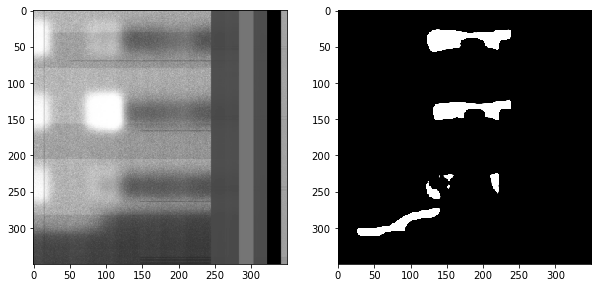

16: pred_dist: [30.069641]


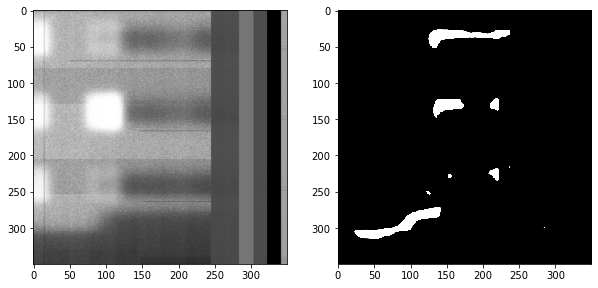

batch 2
1: pred_dist: [28.69034]


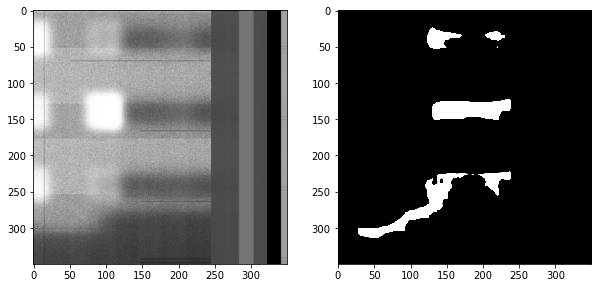

2: pred_dist: [29.85151]


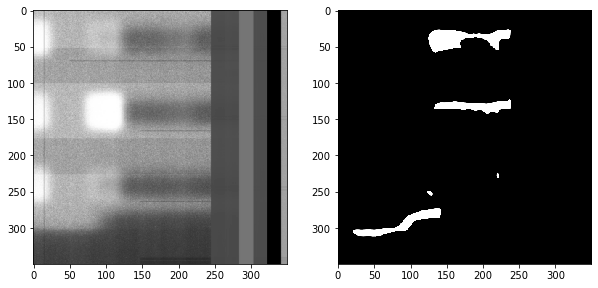

3: pred_dist: [30.287823]


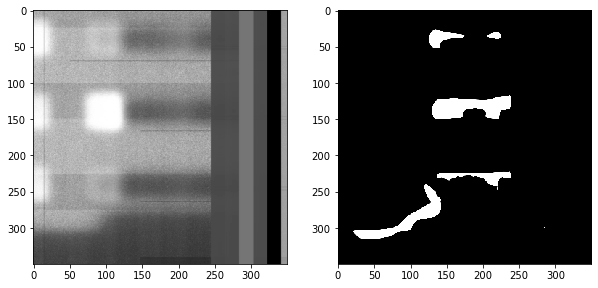

4: pred_dist: [27.72698]


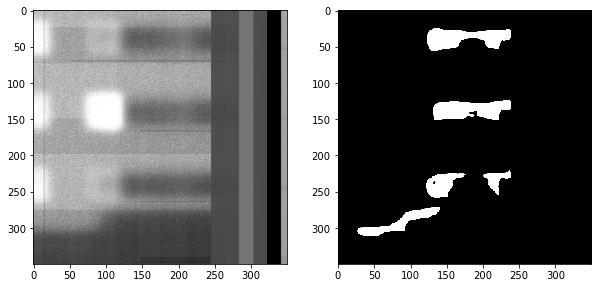

5: pred_dist: [30.344284]


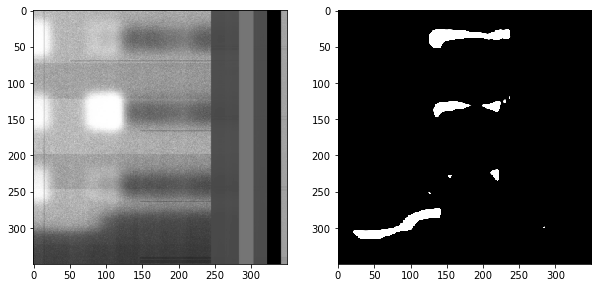

6: pred_dist: [29.242352]


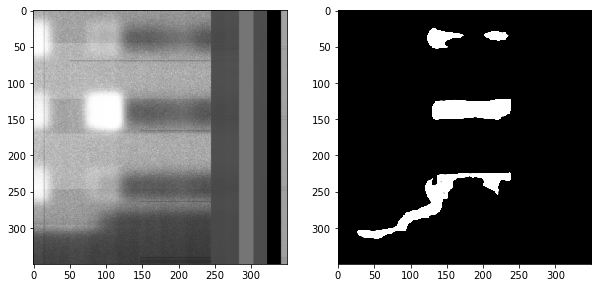

7: pred_dist: [29.183903]


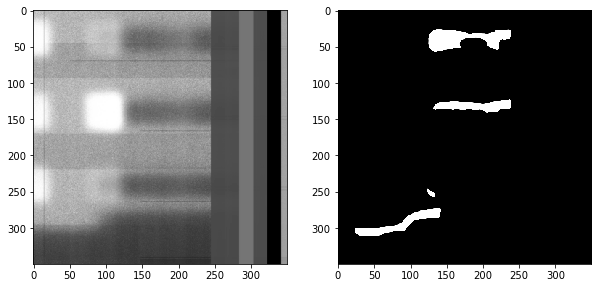

8: pred_dist: [30.222227]


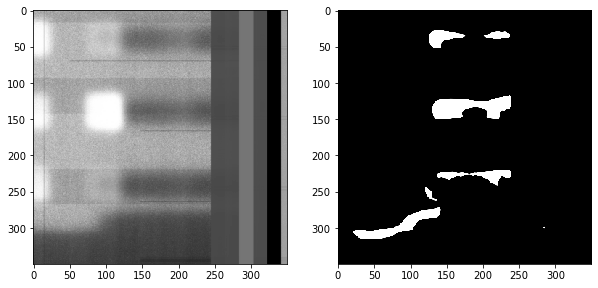

9: pred_dist: [28.382215]


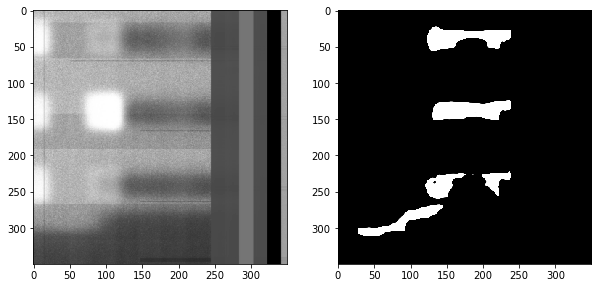

10: pred_dist: [30.176975]


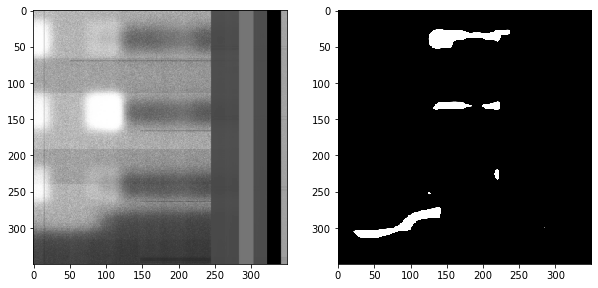

11: pred_dist: [29.580015]


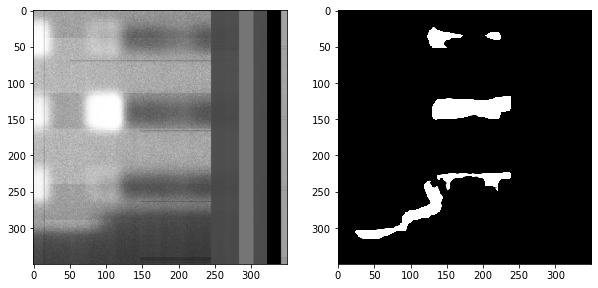

12: pred_dist: [28.454834]


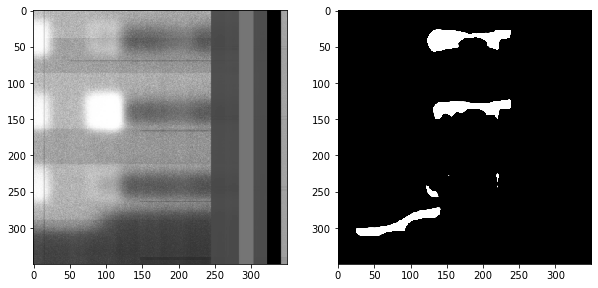

13: pred_dist: [30.164621]


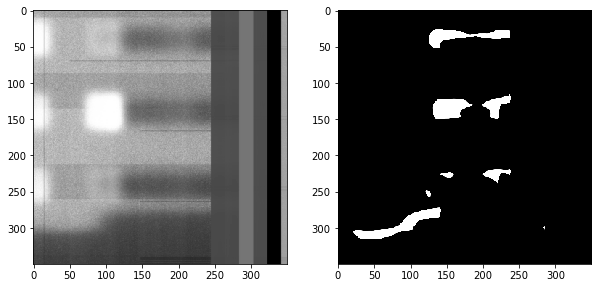

14: pred_dist: [28.590733]


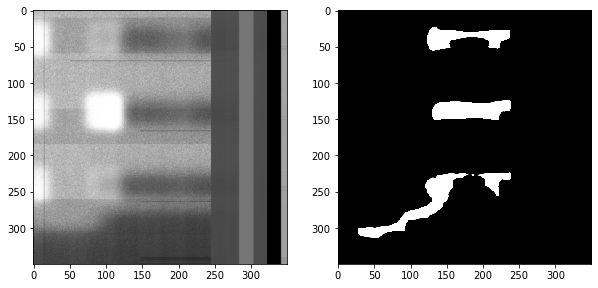

15: pred_dist: [30.133795]


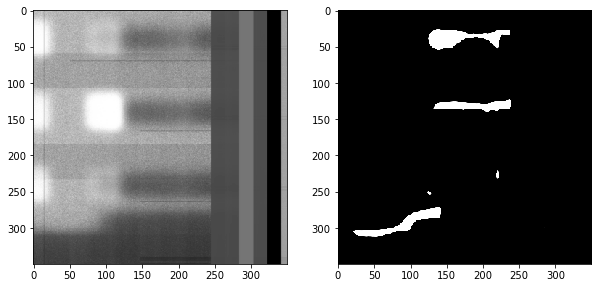

16: pred_dist: [30.361502]


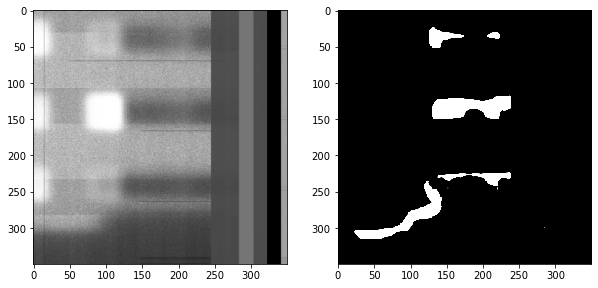

In [17]:
for i, batch in tqdm(enumerate(data_loaders), total=data_lengths // 16, desc="Batch"):

    true_images= batch["image"]
    pred_masks, pred_dists = model(true_images.float().to(device))
    print("batch {}".format(i + 1))
    for j, (img, pr_msk, pr_dist) in enumerate(zip(true_images, pred_masks.cpu().detach().numpy(),
                                                                    pred_dists.cpu().detach().numpy())):
        print("{}: pred_dist: {}".format(j + 1, pr_dist))

        f = plt.figure(figsize=(10, 5))
        f.add_subplot(1, 2, 1)
        plt.imshow(img[0, ...], cmap='gray')
        f.add_subplot(1, 2, 2)
        plt.imshow(pr_msk[0, ...], cmap='gray')
        plt.show(block=True)
        
    if i ==1:
        break

In [32]:
root_folder_pos2 = '/storage/yw18581/data/Pos2_time1934_8bit_cropped/infiles'

data_loaders2, data_lengths2 = define_dataset(root_folder=root_folder_pos2, fname_key='File',
                                              alldata=True, batch_size=1, 
                                            load_mask=False)

In [33]:
data_lengths2

201

batch 1
1: pred_dist: [24.085598]


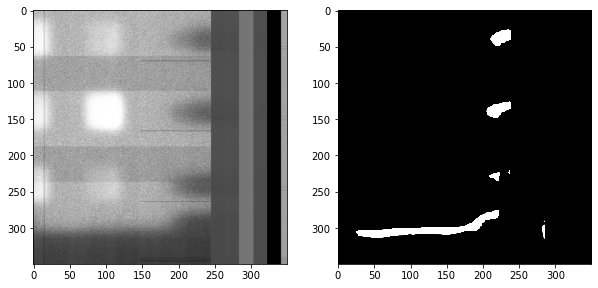

batch 2
1: pred_dist: [27.972565]


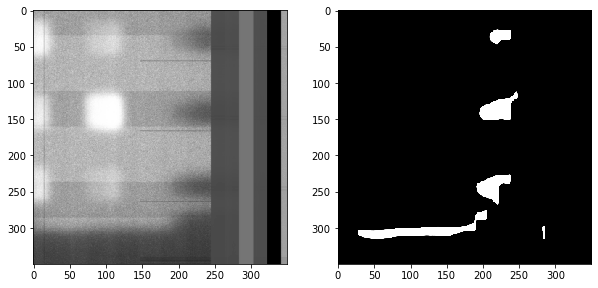

In [34]:
for i, batch in tqdm(enumerate(data_loaders2), total=data_lengths2 // 16, desc="Batch"):

    true_images= batch["image"]
    pred_masks, pred_dists = model(true_images.float().to(device))
    print("batch {}".format(i + 1))
    for j, (img, pr_msk, pr_dist) in enumerate(zip(true_images, pred_masks.cpu().detach().numpy(),
                                                                    pred_dists.cpu().detach().numpy())):
        print("{}: pred_dist: {}".format(j + 1, pr_dist))

        f = plt.figure(figsize=(10, 5))
        f.add_subplot(1, 2, 1)
        plt.imshow(img[0, ...], cmap='gray')
        f.add_subplot(1, 2, 2)
        plt.imshow(pr_msk[0, ...], cmap='gray')
        plt.show(block=True)
        
    if i ==1:
        break

batch 1, corr 0.01
1: pred_dist: [24.990118]


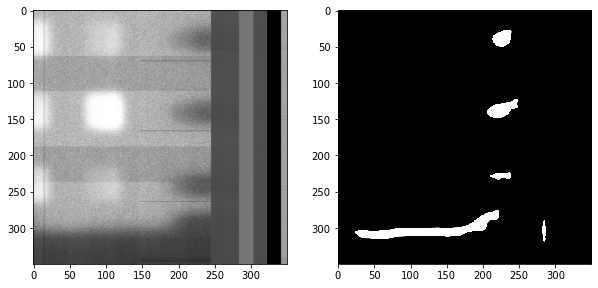

batch 2, corr 0.01
1: pred_dist: [28.326443]


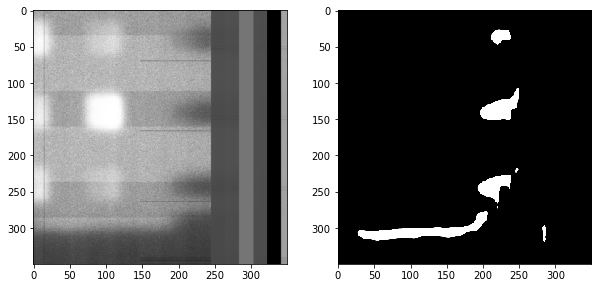

batch 1, corr 0.03
1: pred_dist: [26.85183]


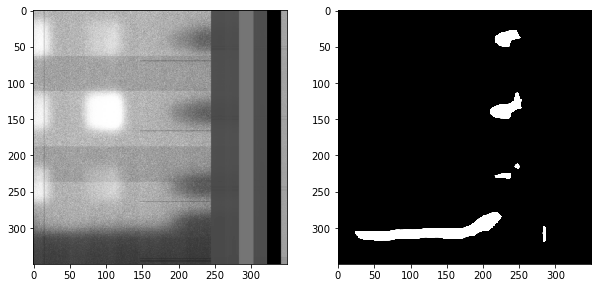

batch 2, corr 0.03
1: pred_dist: [29.311213]


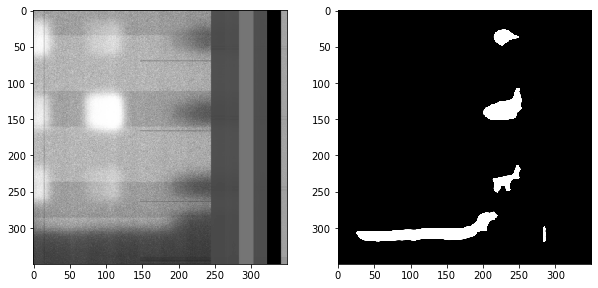

batch 1, corr 0.049999999999999996
1: pred_dist: [28.45004]


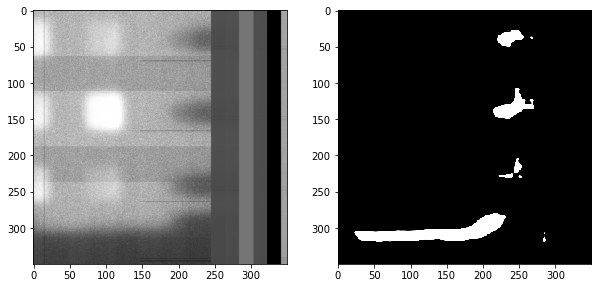

batch 2, corr 0.049999999999999996
1: pred_dist: [30.416656]




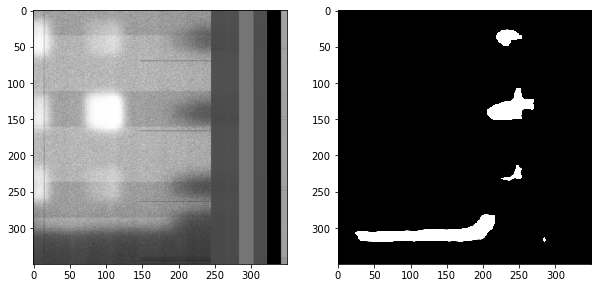

batch 1, corr 0.06999999999999999
1: pred_dist: [29.070728]


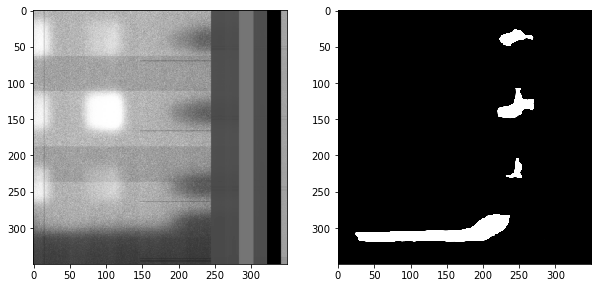

batch 2, corr 0.06999999999999999
1: pred_dist: [30.639194]


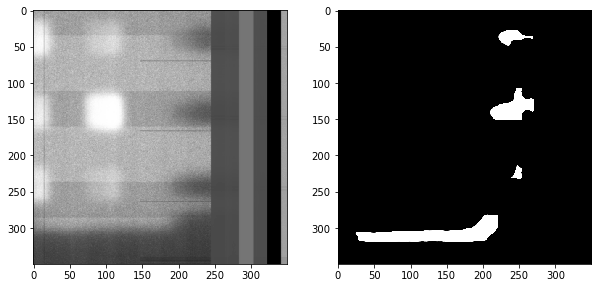

batch 1, corr 0.08999999999999998
1: pred_dist: [28.815033]


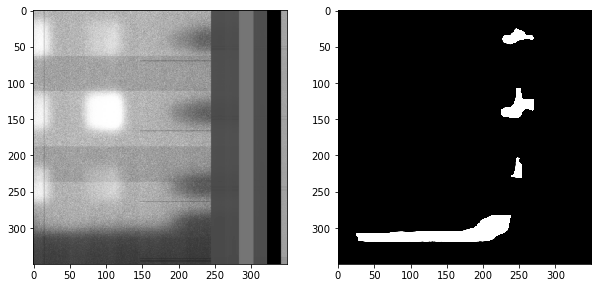

batch 2, corr 0.08999999999999998
1: pred_dist: [30.073965]


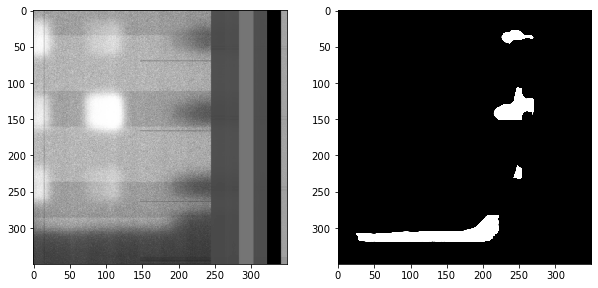

batch 1, corr 0.10999999999999997
1: pred_dist: [27.968142]


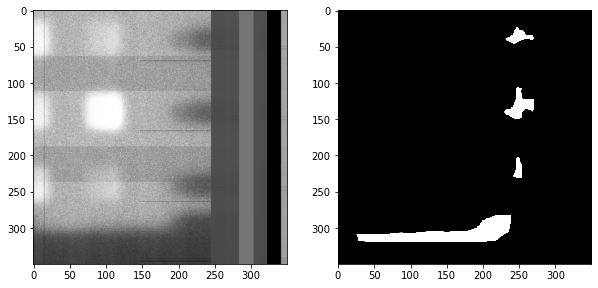

batch 2, corr 0.10999999999999997
1: pred_dist: [29.105442]


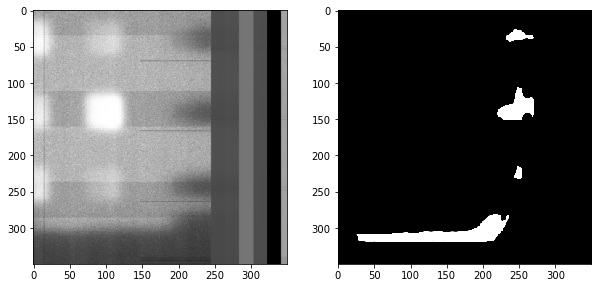

batch 1, corr 0.12999999999999998
1: pred_dist: [26.943775]


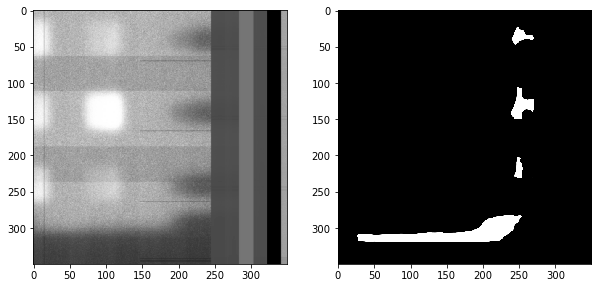

batch 2, corr 0.12999999999999998
1: pred_dist: [27.987045]


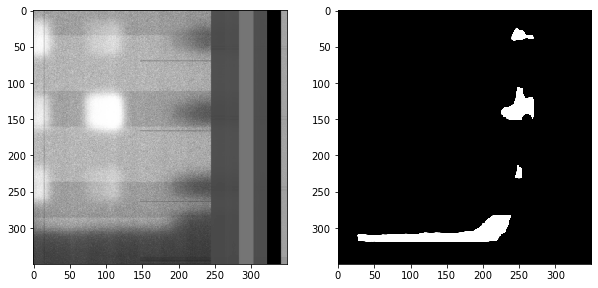

batch 1, corr 0.15
1: pred_dist: [25.692682]


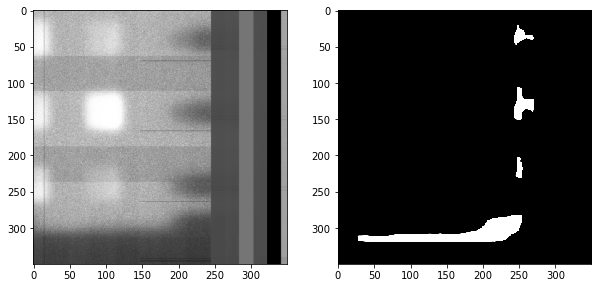

batch 2, corr 0.15
1: pred_dist: [26.60201]


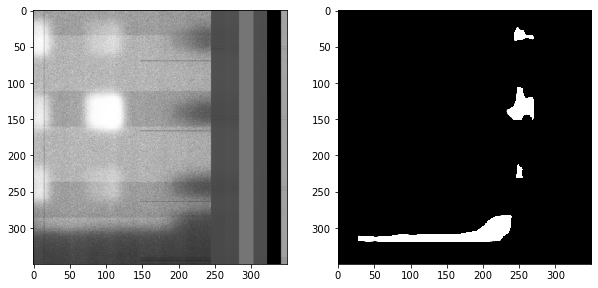

batch 1, corr 0.16999999999999998
1: pred_dist: [24.175735]





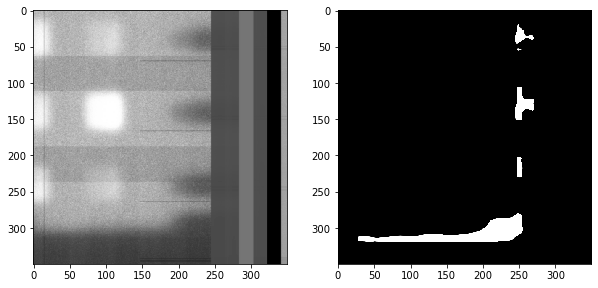

batch 2, corr 0.16999999999999998
1: pred_dist: [24.907974]


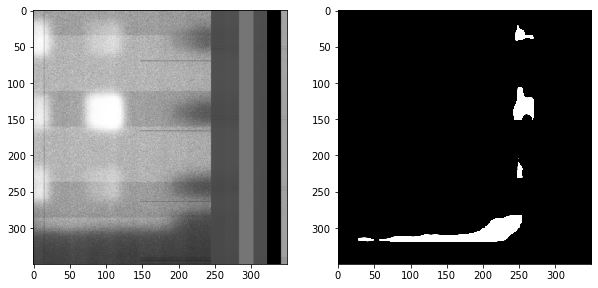

batch 1, corr 0.18999999999999997
1: pred_dist: [22.489641]


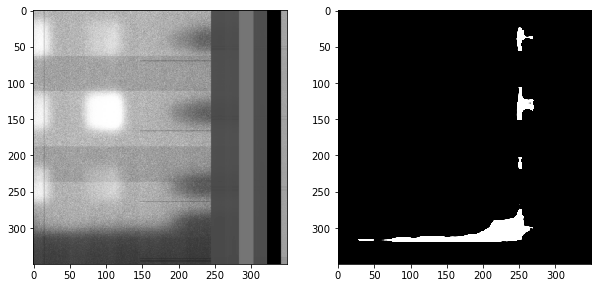

batch 2, corr 0.18999999999999997
1: pred_dist: [23.029259]


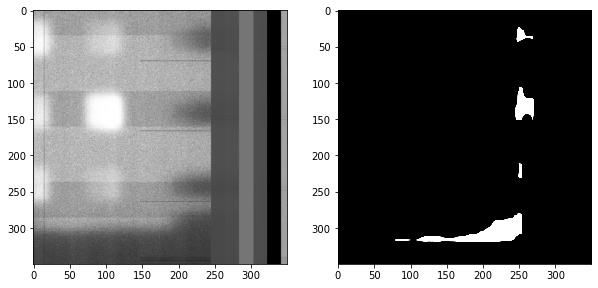

batch 1, corr 0.20999999999999996
1: pred_dist: [20.603172]


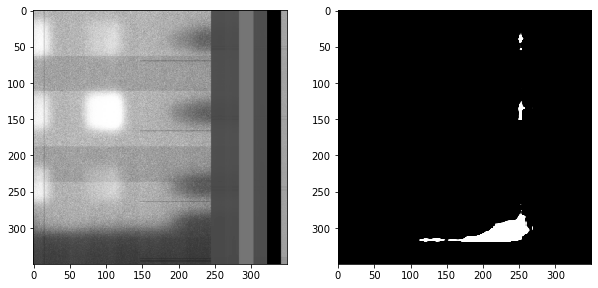

batch 2, corr 0.20999999999999996
1: pred_dist: [20.978865]


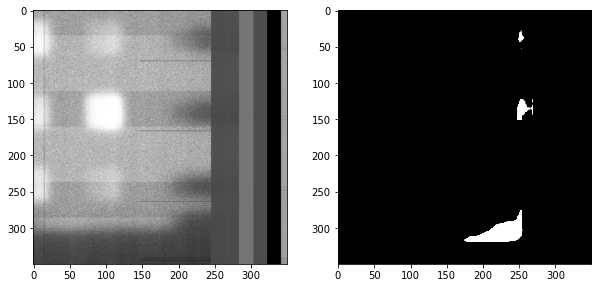

In [35]:
for corr in np.arange(0.01,0.22, 0.02):
    for i, batch in tqdm(enumerate(data_loaders2), total=data_lengths2, desc="Batch"):
        true_images= batch["image"]
        true_images[0]+=corr
        pred_masks, pred_dists = model(true_images.float().to(device))
        print("batch {}, corr {}".format(i + 1,corr))
        for j, (img, pr_msk, pr_dist) in enumerate(zip(true_images, pred_masks.cpu().detach().numpy(),
                                                                    pred_dists.cpu().detach().numpy())):
            print("{}: pred_dist: {}".format(j + 1, pr_dist))

            f = plt.figure(figsize=(10, 5))
            f.add_subplot(1, 2, 1)
            plt.imshow(img[0, ...], cmap='gray')
            f.add_subplot(1, 2, 2)
            plt.imshow(pr_msk[0, ...], cmap='gray')
            plt.show(block=True)

        if i ==1:
            break

In [6]:
img_path = os.path.join(root_folder_pos1, os.listdir(root_folder_pos1)[0])

In [7]:
image =plt.imread(img_path)

In [8]:
IMG_WIDTH = 1400
IMG_HEIGHT = 1400
ROW_SLICE = slice(0, 1400)
COL_SLICE = slice(1000, None)

In [9]:
image.shape

(2800, 2400)

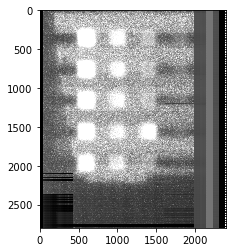

In [10]:
plt.imshow(image, cmap='gray')

/storage/yw18581/src/env_dir/mlearning/lib/python3.7/site-packages/skimage/transform/_warps.py:104: RuntimeWarning: invalid value encountered in true_divide
  np.asarray(output_shape, dtype=float))


LinAlgError: SVD did not converge